In [5]:
import __init__
import matplotlib.pyplot as plt
import numpy as np
import torch
from matplotlib.lines import Line2D
from math import prod
from scipy.ndimage import  binary_dilation,gaussian_filter
from icecream import ic

import utils.bspline as mbs
import utils.torchbox as tb
from utils.toolbox import rgb2gray
from utils.constants import *
import utils.vector_field_to_flow as vff
import pickle
%load_ext autoreload
%autoreload 2
#import draft_experiments.metamorphosis_simplex as ms
import metamorphosis as mt







The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Load and build images

ic| S.min(): 0.0
ic| S_sum.shape: (100, 100)
ic| S[0,0].dtype: dtype('float64')
ic| S[pad+3,pad+3].dtype: dtype('float64')
ic| x.shape: (120, 120, 4)


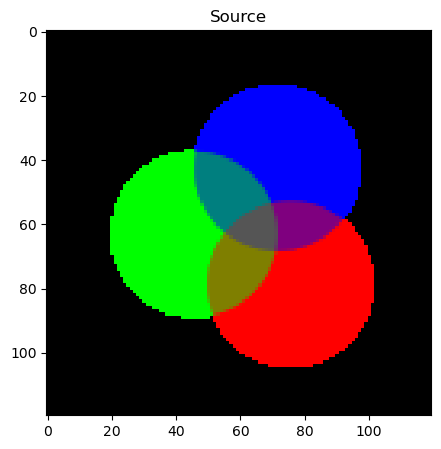

In [6]:
path =  ROOT_DIRECTORY +  '/examples/im2Dbank/'
S_1 = rgb2gray(plt.imread(path + "simplex_tri_s_r.png"))
S_2 = rgb2gray(plt.imread(path + "simplex_tri_s_y.png"))
S_3 = rgb2gray(plt.imread(path + "simplex_tri_s_b.png"))


H,W = S_1.shape
N = 4
eps = 1.e-3
pad = 10
S = np.zeros((H+2*pad,W+2*pad,N)) 
ic(S.min())
S_sum = S_1 + S_2 + S_3 
# T_sum = T_1 + T_2 + T_3 
ic(S_sum.shape)

S[pad:-pad,pad:-pad,0] = S_1
S[pad:-pad,pad:-pad,1] = S_2 
S[pad:-pad,pad:-pad,2] = S_3
S[pad:-pad,pad:-pad,3] = (S_sum == 0).astype("int") #+ eps
if pad > 0:
    S[:pad,:,3] = 1
    S[-pad:,:,3] = 1
    S[:,:pad,3] = 1
    S[:,-pad:,3] = 1
# else:
# S[:pad,:,3] = 1


ic(S[0,0].dtype)
ic(S[pad+3,pad+3].dtype)
def np2torch(x):
    return torch.tensor(x,dtype=torch.float32).permute(2,0,1)[None]

def torch2np(x):
    return x[0].permute(1,2,0).numpy()

def simplex_proj(x):
    ic(x.shape)
    if isinstance(x,np.ndarray):
        x = x / np.sum(x,axis=2,keepdims=True)
        return x
    elif isinstance(x,torch.Tensor):
        x = x / torch.sum(x,dim=1,keepdim=True)
        return x
    else:
        raise ValueError("x must be a numpy array or a torch tensor")
S = simplex_proj(S)

source = np2torch(S)
%matplotlib inline
fig,ax = plt.subplots(1,1,figsize=(10,5))
ax.imshow(S[...,:-1])
ax.set_title("Source")
plt.show()
name = "random01"

## Load seeds

In order to reuse a a pair of toy-exmaple, we can save the seeds of the random generator and load them later. This cell is for loading, the one for saving is after the toy-example construction.

In [10]:
path_save = ROOT_DIRECTORY + f"/examples/result/simplex_result/{name}/"
# Load the seed list from the file
with open(path_save+ f'seed_{name}.pkl', 'rb') as f:
    seed_dict = pickle.load(f)
seed_def = seed_dict["seed_def"]
seed_list = seed_dict["seed_list"]

 ## Build the deformation field

Ici on génere un champs de vecteurs aléatoire à l'aide de besiers.

ic| S.shape: (120, 120, 4), a.shape: (120, 120, 4)
ic| a[0,0]: array([0.22341166, 0.23897658, 0.26101349, 0.27659826])
    a[pad+30,pad+30]: array([0.25279001, 0.25115334, 0.24885244, 0.24720421])
ic| b.shape: torch.Size([1, 4, 120, 120])
ic| b[...,0,0]: tensor([[0.2234, 0.2390, 0.2610, 0.2766]])
    b[...,0,pad+3,pad+3]: tensor([0.2234])
ic| mask.shape: torch.Size([1, 120, 120])


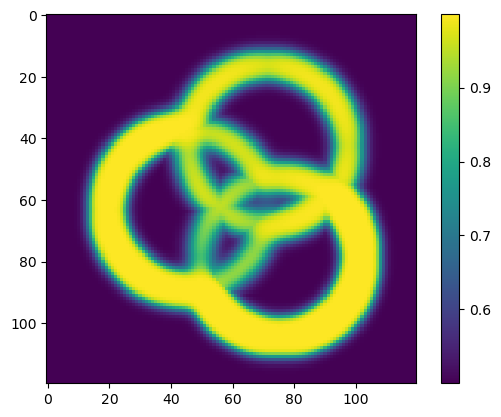

In [7]:
a = gaussian_filter(S, sigma=3)
a[np.where(np.isnan(a))] = 0.
ic(S.shape,a.shape)
ic(a[0,0], a[pad+30,pad+30])
b = np2torch(a)
ic(b.shape)
ic(b[...,0,0], b[...,0,pad+3,pad+3])
c = tb.spacialGradient_2d(b)
mask = c.abs().sum(dim=2).sum(dim=1)*100
# mask = tb.spacialGradient_2d().abs().sum(dim=2).sum(dim=1)*100
a,b = 6,0
mask = 1 / ( 1 + torch.exp(- a*(mask+b)))
# mask[mask>0.3] = 1
ic(mask.shape)

# mask = gaussian_filter(S[...,:-1].sum(axis=2),sigma=2)
a = plt.imshow(mask[0])
plt.colorbar(a)

ic| cm.min(): -0.9806626, cm.max(): 0.99687624
ic| field.shape: torch.Size([1, 120, 120, 2])
ic| mask[0,0]: tensor([7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07,
                       7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07,
                       7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07,
                       7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07,
                       7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07,
                       7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07,
                       7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07,
                       7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07,
                       7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07, 7.4506e-07,
                       7.4506e-07, 7.4506e-07, 7.450

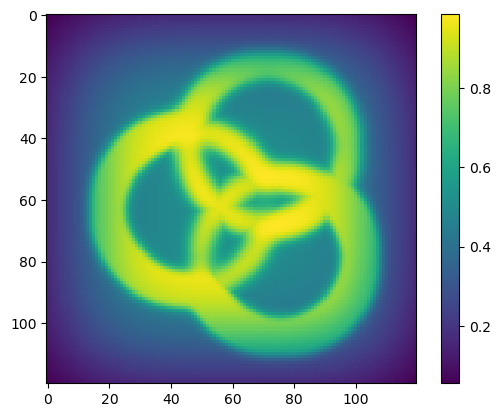

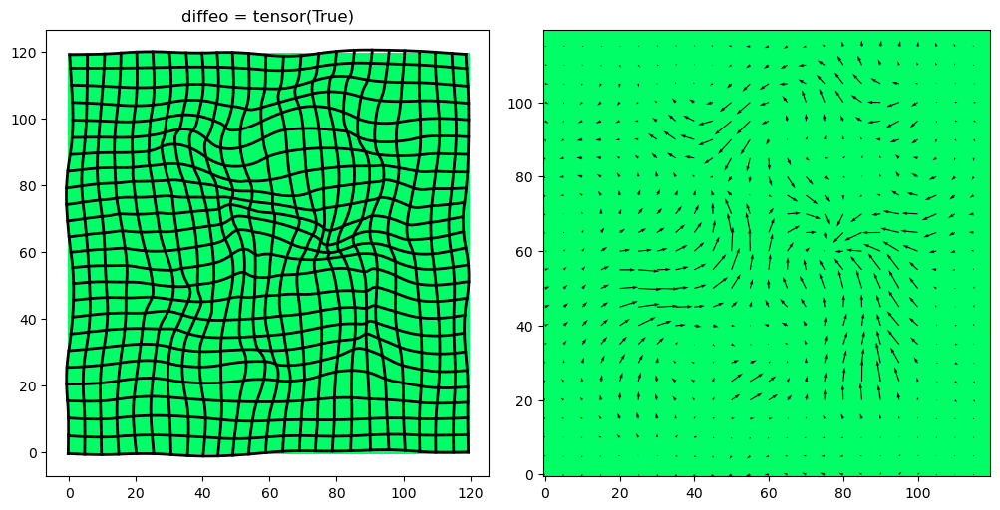

In [9]:

p,q = 10,10
new_seed = True
if new_seed:
    seed_def = np.random.get_state()
else:
    np.random.set_state(seed_def)
    
cm = np.random.random((2,p,q)).astype('float32') *2 - 1
ic(cm.min(),cm.max())

H,W = S.shape[:-1]
n_pts = (H,W) # = np.random.random((6,8))*2-1on peu mettre des tres grandes valeurs ici et l'execution est
                # encore très rapide, mais à éviter pour le plot
degree = (2,2)
field = mbs.field2D_bspline(cm,n_pts,degree,dim_stack=-1)[None] * 10
ic(field.shape)
%matplotlib inline

## Réduire la force du champ de vecteur sur les bords de l'image
id_grid = tb.make_regular_grid((H,W),dx_convention='pixel').numpy()
## mask "Carré" random01
mask_carré = np.exp( - ((id_grid[0,...,0] - H//2)**4/((1.9*H)**3)  + (id_grid[0,...,1] - W//2)**4/(1.9*W)**3) ) 

## mask non nul là où l'image est non nulle random02
# mask = gaussian_filter(S[...,:-1].sum(axis=2),sigma=2)

## Mask non nul aux bords de l'image. random03
mask = tb.spacialGradient_2d(np2torch(gaussian_filter(S, sigma=3))).abs().sum(dim=2).sum(dim=1)*100
a,b = 6,0
ic(mask[0,0],mask[0,1])

mask = 1 / ( 1 + torch.exp(- a*(mask+b)))
mask = mask[0].numpy()
ic(mask[0,0],mask[0,1])
mask *= mask_carré

a = plt.imshow(mask)
plt.colorbar(a)



ic(field.shape,mask.shape, id_grid.shape)
field = field * mask[None,...,None].astype('float32')

ic(field.dtype)
tb.vectField_show(field,step=5,check_diffeo=True)
deform = tb.make_regular_grid((H,W),dx_convention='pixel') + field 

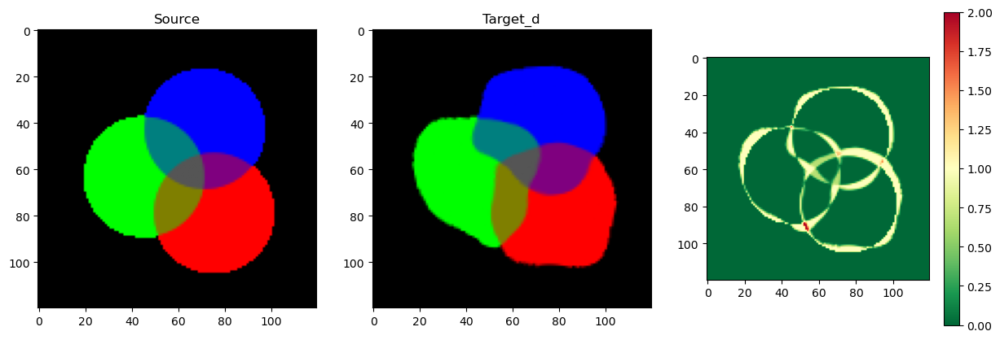

In [10]:
target_d = tb.imgDeform(source,deform, dx_convention='pixel')
fig,ax = plt.subplots(1,3,figsize=(15,5))
ax[0].imshow(S[...,:-1])
ax[0].set_title("Source")
ax[1].imshow(torch2np(target_d)[...,:-1])
ax[1].set_title("Target_d")
diff_s_t = np.sum(np.abs(S[...,:-1] - torch2np(target_d)[...,:-1]),axis=2)
d = ax[2].imshow(diff_s_t,cmap="RdYlGn_r")
fig.colorbar(d, ax=ax[2])

plt.show()

## Generate random intensity addition

In [11]:
p,q = 10,10
n_pts = (H,W) 
degree = (2,2)

new_seed = True
if new_seed:
    seed_list = []


intensity = torch.zeros_like(source)
for i in range(3):
    if new_seed:
        seed_list.append(np.random.get_state())
    else:
        np.random.set_state(seed_list[i])
    cm = np.random.random((p,q)).astype('float32') *3 - 1.5
    cm[:1,:] = 0
    cm[-2:,:] = 0
    cm[:,:2] = 0
    cm[:,-2:] = 0

    surf = mbs.surf_bspline(cm,n_pts,degree)
    surf = 2*surf** 5
    surf[surf>1] = 1
    surf[surf<-1] = -1

    intensity[0,i] = surf

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


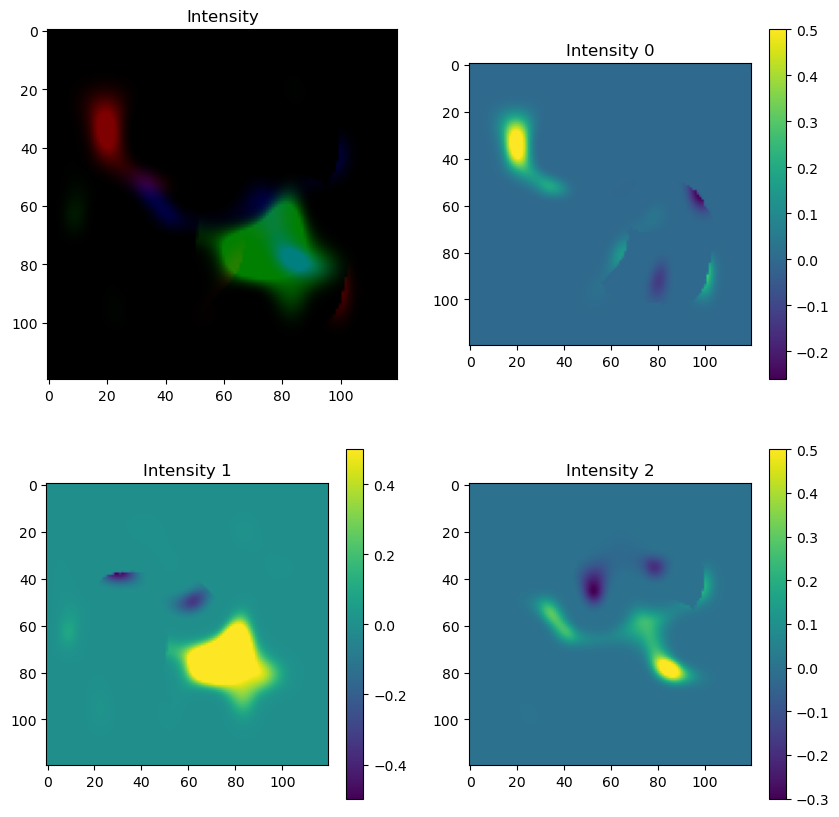

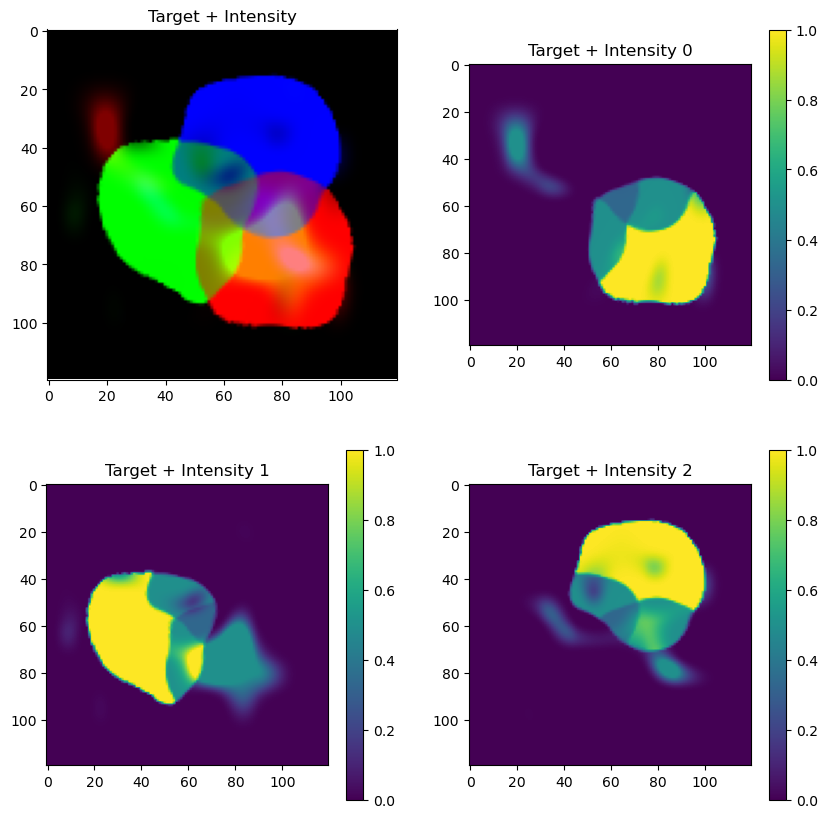

In [12]:
intensity = .5 * intensity


# Nettoyer intensity de manière à ce que la somme des intensités ajoutées à l'image soit inférieure ou egale à 1
# ie 0 <= target_d + intensity <= 1
mask_p1 = target_d + intensity > 1
mask_m1 = target_d < - intensity 
intensity[mask_p1] = 1 - target_d[mask_p1]
intensity[mask_m1] = - target_d[mask_m1] 


%matplotlib inline
fig,ax= plt.subplots(2,2,figsize=(10,10))
ax[0,0].imshow(torch2np(intensity)[...,:-1])
ax[0,0].set_title("Intensity")
a = ax[0,1].imshow(torch2np(intensity)[...,0])
plt.colorbar(a,ax=ax[0,1])
ax[0,1].set_title("Intensity 0")
b = ax[1,0].imshow(torch2np(intensity)[...,1])
plt.colorbar(b,ax=ax[1,0])
ax[1,0].set_title("Intensity 1")
c = ax[1,1].imshow(torch2np(intensity)[...,2])
ax[1,1].set_title("Intensity 2")
plt.colorbar(c,ax=ax[1,1])
fig,ax= plt.subplots(2,2,figsize=(10,10))
ax[0,0].imshow(torch2np(target_d + intensity)[...,:-1])
ax[0,0].set_title("Target + Intensity")
a = ax[0,1].imshow(torch2np(target_d + intensity)[...,0])
plt.colorbar(a,ax=ax[0,1])
ax[0,1].set_title("Target + Intensity 0")
b = ax[1,0].imshow(torch2np(target_d + intensity)[...,1])
plt.colorbar(b,ax=ax[1,0])
ax[1,0].set_title("Target + Intensity 1")
c = ax[1,1].imshow(torch2np(target_d + intensity)[...,2])
ax[1,1].set_title("Target + Intensity 2")
plt.colorbar(c,ax=ax[1,1])



ic| target_d.min(): tensor(0.), target_d.max(): tensor(1.)
ic| intensity.min(): tensor(-0.4996), intensity.max(): tensor(0.5000)
ic| target.min(): tensor(0.), target.max(): tensor(1.)
ic| x.shape: torch.Size([1, 4, 120, 120])
ic| target.min(): tensor(0.), target.max(): tensor(1.)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


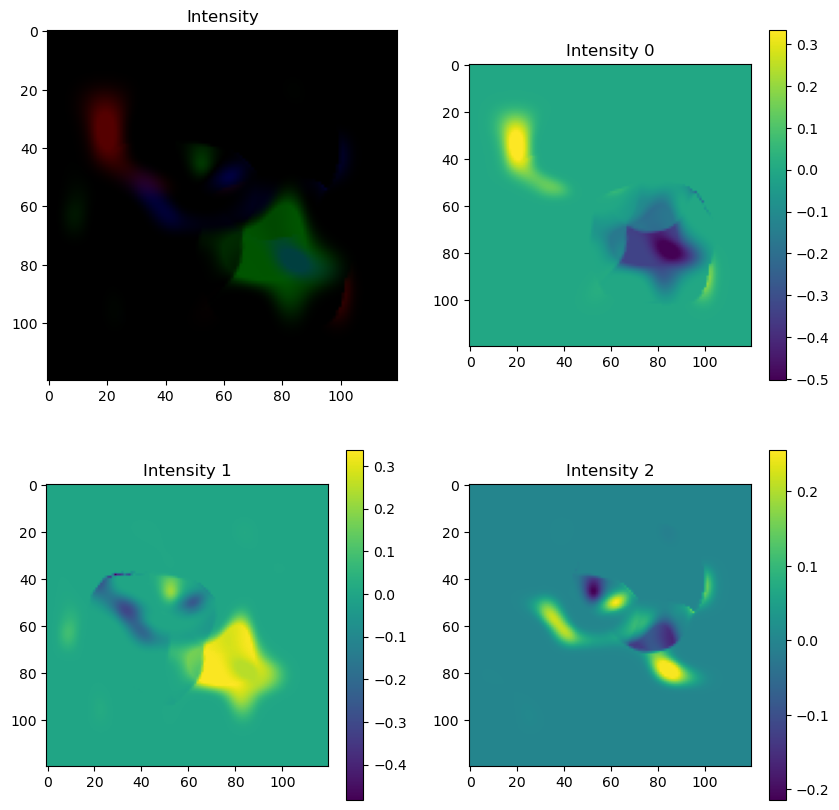

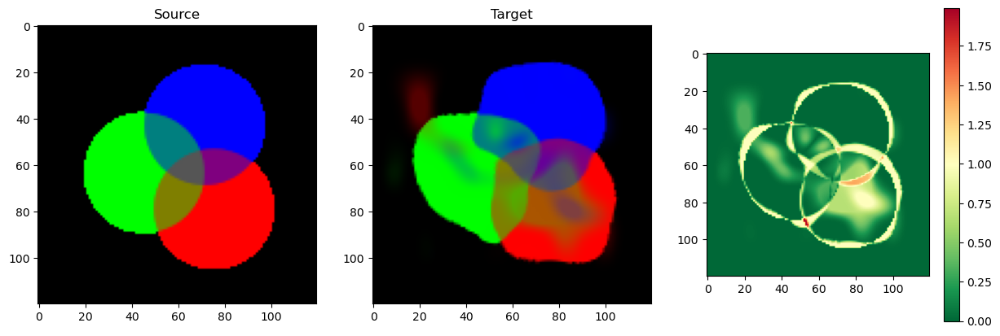

In [13]:
ic(target_d.min(),target_d.max())
ic(intensity.min(),intensity.max() )
target = (target_d + intensity)
# target[target<0] = 0
ic(target.min(),target.max())
target = simplex_proj(target)
ic(target.min(),target.max())

# Ce qu'on as réellement ajouté à target_d après projection sur le simplex
intensity = target - target_d
%matplotlib inline
fig,ax= plt.subplots(2,2,figsize=(10,10))
ax[0,0].imshow(torch2np(intensity)[...,:-1])
ax[0,0].set_title("Intensity")
a = ax[0,1].imshow(torch2np(intensity)[...,0])
plt.colorbar(a,ax=ax[0,1])
ax[0,1].set_title("Intensity 0")
b = ax[1,0].imshow(torch2np(intensity)[...,1])
plt.colorbar(b,ax=ax[1,0])
ax[1,0].set_title("Intensity 1")
c = ax[1,1].imshow(torch2np(intensity)[...,2])
ax[1,1].set_title("Intensity 2")
plt.colorbar(c,ax=ax[1,1])


fig,ax = plt.subplots(1,3,figsize=(15,5))
ax[0].imshow(torch2np(source)[...,:-1])
ax[0].set_title("Source")
ax[1].imshow(torch2np(target)[...,:-1])
ax[1].set_title("Target")
diff_s_t = np.sum(np.abs(S[...,:-1] - torch2np(target)[...,:-1]),axis=2)
d = ax[2].imshow(diff_s_t,cmap="RdYlGn_r")
fig.colorbar(d, ax=ax[2])

# Sauver la seed

In [16]:
name = "random01"

path_save = ROOT_DIRECTORY + f"/examples/result/simplex_result/{name}/"
print(f"Output files will be saved at {path_save}")
if not os.path.exists(path_save):
    os.makedirs(path_save)
import pickle

seed_dict = {"seed_def" : seed_def,
             "seed_list" : seed_list}
with open(path_save+f'seed_{name}.pkl', 'wb') as f:
    pickle.dump(seed_dict, f)

/home/turtlefox/Documents/Doctorat/Demeter/examples/result/simplex_result/random01/


# Recalage

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1556.7056, tensor(504.8535), tensor(494.6062), tensor(340.5953))

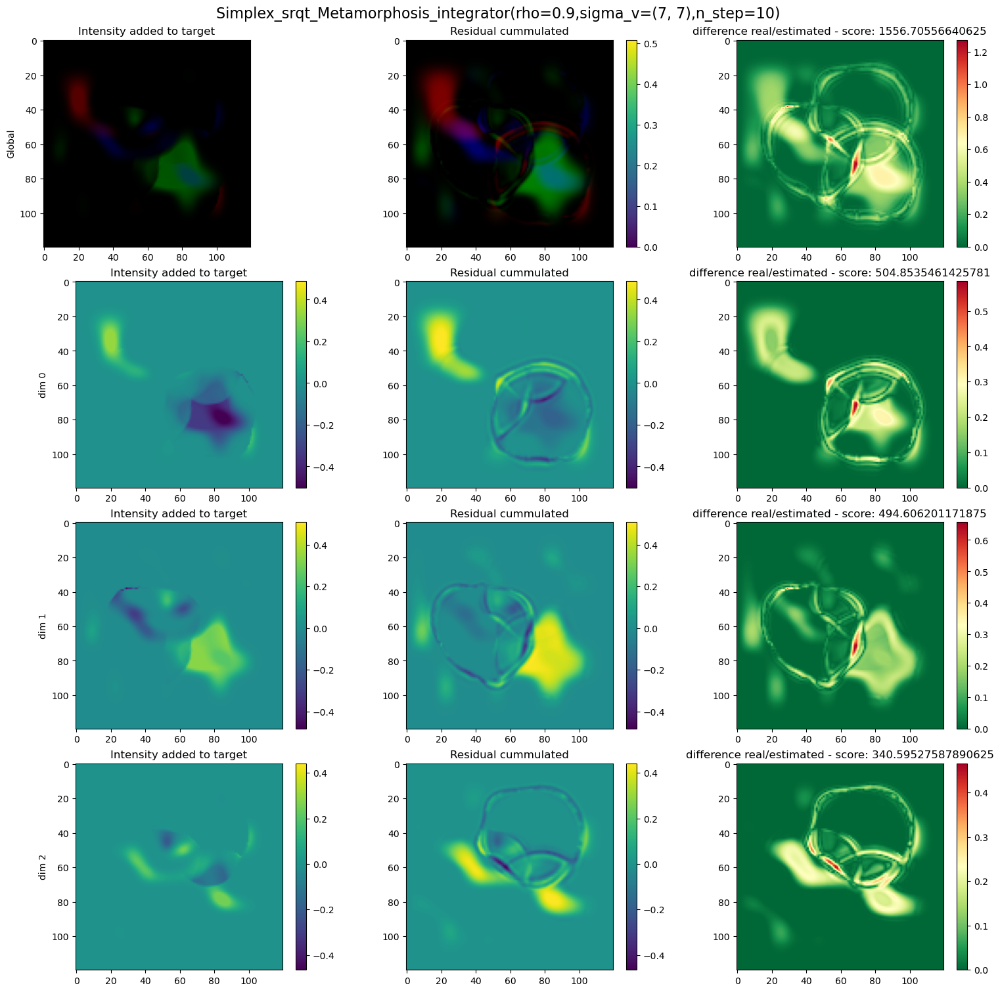

In [32]:
from math import sqrt
def simplex_metamorphosis(source,target,momentum_ini,sigma,rho,n_step=10,n_iter=1000,grad_coef=2,cost_cst = .001 ,plot=False):
    
    sigma = tb.format_sigmas(sigma,len(S.shape[2:]))

    mp = mt.Simplex_sqrt_Metamorphosis_integrator( rho=rho,
                            sigma_v=sigma,
                            n_step=n_step,
                            # debug=True
                            )
    mr = mt.Simplex_sqrt_Shooting(source.clone(),target.clone(),mp,
                                cost_cst=cost_cst,
                                # data_term=data_term,
                                # optimizer_method='LBFGS_torch',
                                # optimizer_method='adadelta'
                                )
    mr.forward(momentum_ini,n_iter=n_iter,grad_coef=grad_coef,plot=plot)
    return mr

def to_plot(img):
    if img.shape[-1] == 3:
        return img
    elif img.shape[-1] == 4:
        return img[...,:-1]

## Residual métric
        
def get_deformator(mp,from_t=0,to_t=None,save=False):
    temporal_integrator = vff.FieldIntegrator(method='temporal',save=save)
    if from_t is None and to_t is None:
        print('Je suis passé par là')
        return temporal_integrator(mp.field_stock/mp.n_step, forward=False)
    # if from_t is None: from_t = 0
    if to_t is None: to_t = mp.n_step 
    if from_t < 0 and from_t >= to_t: 
        raise ValueError(f"from_t must in [0,n_step-1], got from_t ={from_t} and n_step = {mp.n_step}")
    if to_t > mp.n_step: 
        raise ValueError(f"to_t must in [from_t+1,n_step], got to_t ={to_t} and n_step = {mp.n_step}")
    if to_t==1:
        return mp.id_grid.detach().cpu() - mp.field_stock[0][None].detach().cpu() / mp.n_step
    # ic(from_t,to_t,mp.field_stock[from_t:to_t].shape)
    return temporal_integrator(mp.field_stock[from_t:to_t]/mp.n_step, forward=False)

def get_resi_cumul_onTarget(mr, debug = False ) :
    resi_sum = torch.zeros_like(mr.target)
    N = mr.mp.residuals_stock.shape[0]
    if debug:
        fig,ax = plt.subplots(2,N,figsize=(5*N,10),constrained_layout=True)
    
    for i in range(N):
        deform_t = get_deformator(mr.mp,from_t=i,save=False)
        # ic(mr.mp.residuals_stock[i].min(),mr.mp.residuals_stock[i].max())
        resi_sum += sqrt(1 - mr._get_rho_()) * tb.imgDeform(mr.mp.residuals_stock[i][None], deform_t,dx_convention="pixel") / mr.mp.n_step
        # ic(resi_sum.min(),resi_sum.max())
        if debug:
            to_show_r = resi_sum.squeeze().permute(1,2,0).numpy()
            ax[0,i].imshow(to_show_r[...,:-1])
            ax[1,i].imshow(mr.mp.residuals_stock[i].squeeze().permute(1,2,0).numpy()[...,:-1])
            set_ticks_off(ax)
    return resi_sum    
    
def residual_quality_metric(mr,resi_rhoInfty):
    resi_sum = get_resi_cumul_onTarget(mr,debug=False)
    return torch.sum((resi_sum - resi_rhoInfty ) ** 2)
    
def plot_endresult(mr,save=False, retrun_all=False):
    image_ts = mr.mp.image.squeeze().permute(1,2,0).numpy() **2
    momentum_ts = mr.mp.momentum.permute(0,2,3,1).squeeze().detach().numpy()
    
    # ic(image_ts.shape)
    residual_cumul = get_resi_cumul_onTarget(mr,debug=False).permute(0,2,3,1)[0]
    #residual_ts = mr.mp.residuals.squeeze().permute(1,2,0).numpy() 
    
    deform = mr.mp.get_deformation()
    im_deformed_only = tb.imgDeform(source,mr.mp.get_deformator(),dx_convention="pixel")
    im_deformed_only = im_deformed_only.squeeze().permute(1,2,0).numpy() 
    
    diff_im_t = np.sum(np.abs(image_ts-torch2np(target)),axis=-1)
    diff_im_def = np.sum(np.abs(im_deformed_only-torch2np(target)),axis=-1)

    metric_ssd = np.sqrt(np.sum((image_ts-torch2np(target))**2))
    metric_sdd_def_only = np.sqrt(np.sum((im_deformed_only-torch2np(target))**2))

    fig,ax = plt.subplots(3,3,figsize=(10,10),constrained_layout=True)
    fig.suptitle(mr.mp, fontsize=16)
    ax[0,0].imshow(to_plot(torch2np(source)))
    ax[0,0].set_title("Source")
    ax[0,1].imshow(to_plot(torch2np(target)))
    ax[0,1].set_title("Target")
    tb.gridDef_plot_2d(deform,step=3,ax=ax[0,2],check_diffeo=False,origin = 'upper')
    
    
    ax[1,1].imshow(to_plot(image_ts))
    ax[1,1].set_title("Image")
    ax[1,0].imshow(to_plot(momentum_ts))
    ax[1,0].set_title("Momentum")
    # ic(residual_cumul.shape)
    d = ax[1,2].imshow(to_plot(residual_cumul))
    fig.colorbar(d, ax=ax[1,2])
    ax[1,2].set_title("Cumulative residual")
    
    ax[2,0].imshow(to_plot(im_deformed_only))
    ax[2,0].set_title(f"only Deformed Source")
    d = ax[2,1].imshow(diff_im_t,cmap="RdYlGn_r")
    fig.colorbar(d, ax=ax[2,1])
    ax[2,1].set_title(f"Diff Image Target = {metric_ssd:.2f}")
    d = ax[2,2].imshow(diff_im_def,cmap="RdYlGn_r")
    fig.colorbar(d, ax=ax[2,2])
    ax[2,2].set_title(f"Diff Image only deformed m = {metric_sdd_def_only:.2f}")
    
    
    set_ticks_off(ax)
    if save:
        plt.savefig(f"{path_save}{name}_{mr.mp}_summary.png")
    
    if retrun_all:
        return {"metric_ssd" : metric_ssd,
                "metric_sdd_def_only" : metric_sdd_def_only,
                "im_deformed_only" : im_deformed_only,
                "image_ts" : image_ts,
                "momentum_ts" : momentum_ts,
                "residual_cumul" : residual_cumul
                }
    else:
        return metric_ssd,metric_sdd_def_only
        
def show_integration(mr,save=False):
    to_show_q = mr.mp.image_stock.squeeze().permute(0,2,3,1).numpy() **2
    to_show_r = mr.mp.residuals_stock.squeeze().permute(0,2,3,1).numpy()
    to_show_r = (to_show_r ** 2).sum(axis=-1)
    to_show_p = mr.mp.momentum_stock.squeeze().permute(0,2,3,1).numpy()
    N,D = to_show_q.shape[0],to_show_q.shape[-1]
    # %matplotlib qt
    fig,ax = plt.subplots(3,N,figsize=(N*3,6),constrained_layout=True)
    ax[0,0].set_ylabel("Image")
    ax[1,0].set_ylabel("Residual")
    ax[2,0].set_ylabel("Momentum")
    for n in range(N):
        ax[0,n].imshow(to_plot(to_show_q[n]))
        ax[0,n].set_title(f"t ={n+1}")
        # ax[1,n].imshow(to_show_r[n,:,:,:-1])
        ax[1,n].imshow(to_show_r[n],vmin=to_show_r.min(),vmax=to_show_r.max())

        ax[2,n].imshow(to_plot(to_show_p[n]))
    set_ticks_off(ax)
    
    if save:
        plt.savefig(f"{path_save}{name}_{mr.mp}_integration.png")
        

from matplotlib.collections import LineCollection

def plot_deform_cmp(mr,deform,save=False):
    deform_simi = (mr.mp.get_deformator() - deform).abs().sum(dim=-1)
    deform_score = deform_simi.sum()
    fig, ax = plt.subplots(1,3,figsize=(15,5),constrained_layout=True)
    fig.suptitle(mr.mp, fontsize=16)
    a = ax[0].imshow(deform_simi[0],cmap="RdYlGn_r")
    plt.colorbar(a,ax=ax[0])
    ax[0].set_title(f"difference real/estimated deformation ({deform_score:.2f})")
    
    c1, c2 = 'C1','C2'
    tb.gridDef_plot_2d(mr.mp.get_deformator(),step=5,ax=ax[1],check_diffeo=False,color=c1)
    tb.gridDef_plot_2d(deform,step=5,ax=ax[1],check_diffeo=False,color=c2)
    
    tb.quiver_plot(mr.mp.get_deformator() - mr.mp.id_grid,step=5,ax=ax[2],color=c1)
    tb.quiver_plot(deform - mr.mp.id_grid,step=5,ax=ax[2],color=c2)
    
    custom_lines = [Line2D([0], [0], color=c1, lw=4),
                    Line2D([0], [0], color=c2, lw=4),
                    ]
    ax[1].legend(custom_lines, ['estimated', 'true'])
    ax[2].legend(custom_lines, ['estimated', 'true'])
    
    if save:
        plt.savefig(f"{path_save}{name}_{mr.mp}_deform_cmp.png")
    return deform_score

def plot_resi_cmp(end_result,save = False):
    """
    
    :param mr: 
    :param end_result: dict produced by plot_endresult
    :return: 
    """
    # {"metric_ssd" : metric_ssd,
    #                 "metric_sdd_def_only" : metric_sdd_def_only,
    #                 "im_deformed_only" : im_deformed_only,
    #                 "image_ts" : image_ts,
    #                 "momentum_ts" : momentum_ts,
    #                 "residual_cumul" : residual_cumul
    #                 }
    
    # intensity.shape: torch.Size([1, 4, 120, 120])
    # end_result['residual_cumul'].shape: torch.Size([120, 120, 4])
    # ic(intensity.min(),intensity.max(),end_result['residual_cumul'].min(),end_result['residual_cumul'].max() )
    # ic(intensity.shape,end_result['residual_cumul'].shape)
    # ic(end_result['residual_cumul'].permute(2,0,1)[None].shape)
    # resi_simi = (end_result['residual_cumul'] -  torch2np(intensity)[0]).abs().sum(dim=-1)
    resi_cumul = end_result['residual_cumul'].permute(2,0,1)[None]
    resi_simi = (resi_cumul -  intensity).abs().numpy().sum(axis=1)[0]
    # ic(resi_simi.shape,resi_simi.sum(),resi_simi.min(),resi_simi.max())
    resi_simi_score = (resi_simi.sum(),)
    
    fig,ax= plt.subplots(4,3,figsize=(15,15),constrained_layout=True)
    fig.suptitle(mr.mp, fontsize=16)
    ax[0,0].imshow(torch2np(intensity)[...,:-1])
    ax[0,0].set_title("Intensity added to target")
    ax[0,0].set_ylabel("Global")
    a = ax[0,1].imshow(end_result['residual_cumul'][...,:-1])
    plt.colorbar(a,ax=ax[0,1])
    ax[0,1].set_title("Residual cummulated")
    
    c = ax[0,2].imshow(resi_simi,cmap="RdYlGn_r")
    plt.colorbar(c,ax=ax[0,2])
    ax[0,2].set_title(f"difference real/estimated - score: {resi_simi_score[0]}")
    
    for i in range(3):
        # ic(resi_cumul[0,i].shape, intensity[0,i].shape)
        resi_simi_i = (resi_cumul[0,i] -  intensity[0,i]).abs()
        resi_simi_score = resi_simi_score + (resi_simi_i.sum(),)
        min_r = np.minimum(intensity[0,i].min(),resi_cumul[0,i].min())
        max_r = np.maximum(intensity[0,i].max(),resi_cumul[0,i].max())
        # ic(i,min_r,max_r)
        
        b = ax[i+1,0].imshow(torch2np(intensity)[...,i],vmin=min_r,vmax=max_r)
        plt.colorbar(b,ax=ax[i+1,0])
        ax[i+1,0].set_title("Intensity added to target")
        ax[i+1,0].set_ylabel(f"dim {i}")
        a = ax[i+1,1].imshow(end_result['residual_cumul'][...,i],vmin=min_r,vmax=max_r)
        plt.colorbar(a,ax=ax[i+1,1])
        ax[i+1,1].set_title("Residual cummulated")
        
        c = ax[i+1,2].imshow(resi_simi_i,cmap="RdYlGn_r")
        plt.colorbar(c,ax=ax[i+1,2])
        ax[i+1,2].set_title(f"difference real/estimated - score: {resi_simi_score[i+1]}")
        
    if save:
        plt.savefig(f"{path_save}{name}_{mr.mp}_resi_cmp.png")

    return resi_simi_score

class SimplexPlot():
    
    def __init__(self, fig_ax =None, origin = (0,0),grid=True):
        self.e_1 = np.array([1.,0.])
        self.e_2 = np.array([0.5,np.sqrt(3)/2])
        self.O = origin
        
        if fig_ax is not None:
            self.fig, self.ax = fig_ax
        else:
            self.fig, self.ax = plt.subplots(1,1,figsize=(5,5))
        if grid:
            self._add_grid_()
        self.ax.plot(
            [self.O[0],self.O[0]+self.e_1[0],self.O[0]+self.e_2[0],self.O[0]],
            [self.O[1],self.O[1]+self.e_1[1],self.O[1]+self.e_2[1],self.O[1]],
            'k-'
        )
        self.ax.plot(self.O[0] + .5,self.O[1] + np.sqrt(3)/6,'.',color='lightgray')
        c = .05
        self.ax.text(self.O[0] - c,self.O[1] - c,"[1,0,0]")
        self.ax.text(self.O[0] + self.e_1[0] - c,self.O[1] + self.e_1[1] - c,"[0,1,0]")
        self.ax.text(self.O[0] + self.e_2[0] + c,self.O[1] + self.e_2[1] ,"[0,0,1]")
        
        
        self.ax.set_aspect('equal')
    
    def get_fig(self):
        return self.fig
    
    def get_ax(self):
        return self.ax
    
    def _add_grid_(self):
        for l in [.1,.2,.3,.4,.5]:
            a,b,c = 0,l,1-l
            coords = [
                [a,b,c],
                [b,a,c],
                [b,c,a],
                [a,c,b],
                [c,a,b],
                [c,b,a],
                [a,b,c]
            ]
            coords = self.convert_simplex_to_cartesian(np.array(coords))
            color = 'gray' if l*10 % 2 == 0 else 'lightgray'
            ls = '--' if l*10 % 2 == 0 else '-'
            
            self.add_points(coords,marker='',color=color,linestyle=ls,linewidth=0.2)
    
    def convert_simplex_to_cartesian(self,S):
        if S.shape == (3,):
            if S.sum() != 1:
                if abs(S.sum() - 1) > 1e-3:
                    raise ValueError(f"Not a simplex! Sum of S = {S.sum()}")
                else:
                    print(f"Warning: S is not a simplex, sum = {S.sum()}")
            return np.array(       
                S[1] * self.e_1 + S[2] * self.e_2
            )
        if S.shape[0] > 1 and S.shape[1] == 3:
            return (S[:,1] * self.e_1[:,None] 
                    + S[:,2] * self.e_2[:,None])
        
    def add_points(self,points,norm = (-1,1),**kwargs):
        if kwargs["color"] == 'dist_to_simplex' and points.shape[-1] ==2:
            raise ValueError("We can show distance to simplex with coordinates in the simplex only."
                             f"Got points.shape = {points.shape} and color = 'dist_to_simplex'")
        if kwargs["color"] == 'dist_to_simplex':
            pts_dist = points.sum(axis=1) - 1
            
        if points.shape[-1] == 3:
            points = self.convert_simplex_to_cartesian(points)
        
        if kwargs["color"] == 'dist_to_simplex':
            if type(norm) is str:
                min_max = max(abs(pts_dist.min()),abs(pts_dist.max()))
                norm = (-min_max,min_max)
            points[0] = self.O[0] + points[0]
            points[1] = self.O[1] + points[1]
            points = points.T.reshape(-1,1,2)
            segments = np.concatenate([points[:-1],points[1:]],axis=1)
            lc = LineCollection(
                segments,
                cmap='jet',
                norm=plt.Normalize(norm[0],norm[1])
            )
            lc.set_array(pts_dist)
            b =self.ax.add_collection(lc)

            self.ax.scatter(points[:,:,0],points[:,:,1],
                            c=pts_dist,
                            cmap='jet',
                            norm=plt.Normalize(norm[0],norm[1])
            )
            self.fig.colorbar(b, ax=self.ax,fraction=0.046, pad=0.04)
        else:
            self.ax.plot(self.O[0] + points[0],self.O[1] +points[1],**kwargs)

def plot_trajectory(mr,coord_x,coord_y,save=False):

    imgs = mr.mp.image_stock.permute(0,2,3,1).numpy() **2
    ss = mr.source.squeeze().permute(1,2,0).numpy() **2
    
    
    fig,ax = plt.subplots(1,3,figsize=(10,5))
    ax[0].imshow(torch2np(source)[...,:-1])
    ax[0].plot(coord_x,coord_y,'db')
    ax[0].set_title("Source")
    ax[1].imshow(torch2np(target)[...,:-1])
    ax[1].plot(coord_x,coord_y,'sb')
    ax[1].set_title("Target")
    
    sp = SimplexPlot(fig_ax=(fig,ax[2]))
    sp.add_points(imgs[:,coord_y,coord_x,:-1], marker='o',color='C1',norm="min_max", label="Image")
    sp.add_points(torch2np(source)[coord_y,coord_x,:-1],marker='d',color='b', label="Source")
    sp.add_points(torch2np(target)[coord_y,coord_x,:-1],marker='s',color='g', label="Target")
    axi = sp.get_ax()
    axi.legend()
    axi.set_title(f"n_step = {mr.mp.n_step},lamdba = {mr.cost_cst}, rho = {mr._get_rho_()}")
    axi.text(0.7,.7,f"(x,y) = ({coord_x},{coord_y})")
    
    if save:
        plt.savefig(f"{path_save}{name}_{mr.mp}_trajectory.png")
     
# get_resi_cumul_onTarget(mr,debug=True)
# plot_endresult(mr,save=False)
plot_resi_cmp(end_result,mr)
# plot_deform_cmp(mr,deform,save=False)

## Run

Progress: [##########] 100.00% Done...  ,   40.59).
 (ssd :  ,   40.61).

ic| mr.source[0,:,0,0]**2: tensor([0., 0., 0., 1.])
ic| mr.target[0,:,0,0]**2: tensor([0., 0., 0., 1.])
ic| mr.mp.image[0,:,0,0]**2: tensor([1.1556e-30, 2.9926e-32, 0.0000e+00, 1.0000e+00])
    (mr.mp.image[0,:,0,


Computation of forward done in  0:03:39s and 0.654cents  s


0]**2).sum(): tensor(1.)
ic| (mr.mp.image**2).sum(axis=1).mean(): tensor(1.)


SSD = 0.00, distance to simplex = 0.000


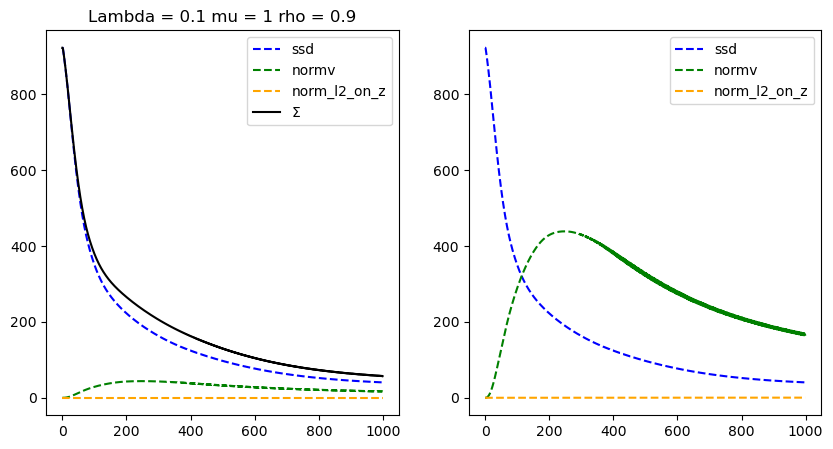

In [28]:
# # source = torch.tensor(S).permute(2,0,1).unsqueeze(0).float()
# # target = torch.tensor(T).permute(2,0,1).unsqueeze(0).float()
# ic(source.shape,target.shape)
# print(S[0,0])
# print(source[0,:,0,0])




momentum_ini = torch.zeros_like(source)
momentum_ini.requires_grad = True

# momentum_ini = mr.to_analyse[0]
# momentum_ini.requires_grad = True

sigma = (7,7)
rho = .9


mr = simplex_metamorphosis(source,target,momentum_ini,sigma,rho,
                           n_step=10,
                           n_iter=1000,
                           grad_coef=1,
                           cost_cst=.1,
                           plot=False)
ic(mr.source[0,:,0,0]**2)
ic(mr.target[0,:,0,0]**2)
ic(mr.mp.image[0,:,0,0]**2, (mr.mp.image[0,:,0,0]**2).sum())

ic((mr.mp.image**2).sum(axis=1).mean())

ssd = ((mr.mp.image**2 - mr.target**2)**2).sum()/prod(mr.mp.image.shape[2:])
dist_to_simplex = float((mr.mp.image**2).sum(axis=1).mean()-1)
print(f"SSD = {ssd:.2f}, distance to simplex = {dist_to_simplex:.3f}")
%matplotlib inline
mr.plot_cost()

In [15]:
mr.save(f"{name}",f"rho_{rho:.2f}")

I am saving mp
No landmark detected
Optimisation saved in /home/turtlefox/Documents/Doctorat/gliomorph/my_metamorphosis/saved_optim/2D_02_07_2024_random02_to_rho_0.95_000.pk1



('2D_02_07_2024_random02_to_rho_0.95_000.pk1',
 '/home/turtlefox/Documents/Doctorat/gliomorph/my_metamorphosis/saved_optim/')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| residual_cumul.shape: torch.Size([120, 120, 4])
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| intensity.min(): tensor(-0.5023)
    intensity.max(): tensor(0.4711)
    end_result['residual_cumul'].min(): tensor(-0.6627)
    end_result['residual_cumul'].max(): tensor(0.5081)
ic| intensity.shape: torch.Size([1, 4, 120, 120])
    end_result['residual_cumul'].shape: torch.Size([120, 120, 4])
ic| end_result['residual_cumul'].permute(2,0,1)[None].shape: torch.Size([1, 4, 120, 120])
ic| resi_simi.shape: (120, 120)
    resi_simi.sum(): 1556.7056
    resi_simi.min(): 0.0
    resi_simi.max(): 1.2718923
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).

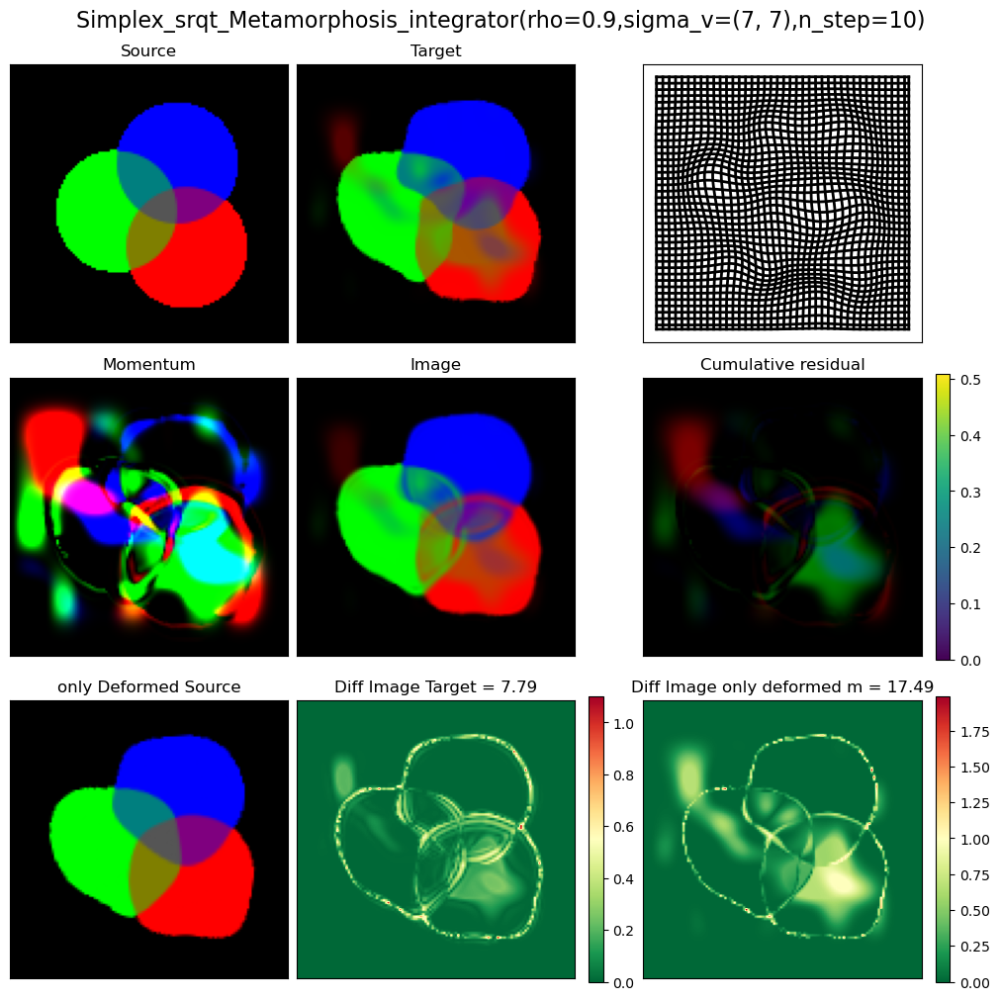

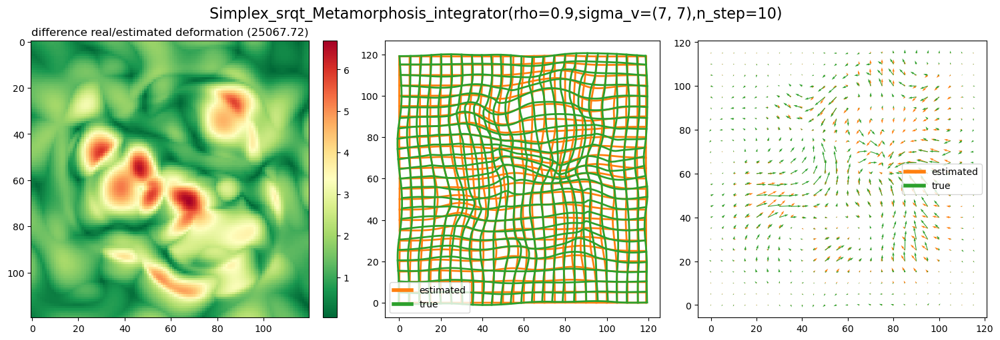

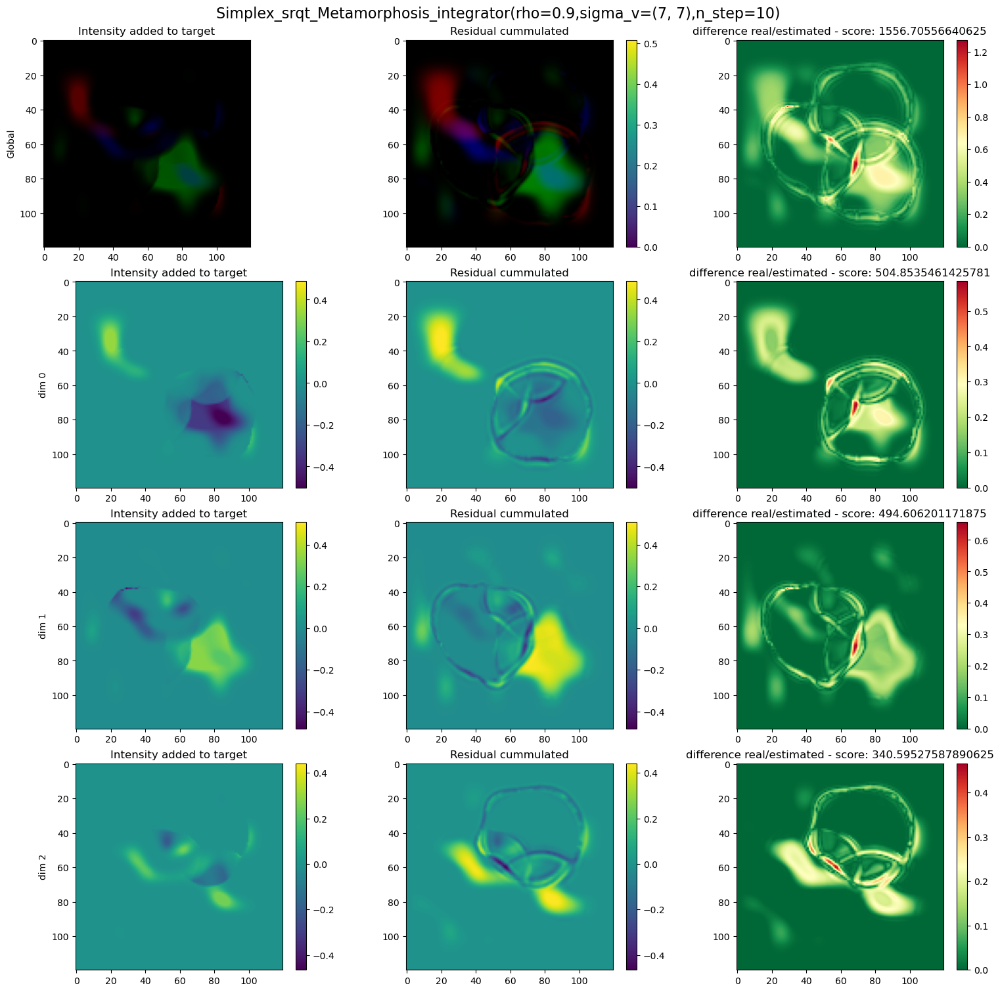

In [31]:

save = False
end_result = plot_endresult(mr,save=save, retrun_all=True)

end_result['deform_score'] =  plot_deform_cmp(mr,deform,save=save)

end_result['resi_score'] = plot_resi_cmp(end_result,save=save)

In [22]:
ic(end_result.keys())

ic| 2993307745.py:1 in <module>
    end_result.keys(): dict_keys(['metric_ssd', 'metric_sdd_def_only', 'im_deformed_only', 'image_ts', 'momentum_ts', 'residual_cumul', 'deform_score', 'resi_score'])


dict_keys(['metric_ssd', 'metric_sdd_def_only', 'im_deformed_only', 'image_ts', 'momentum_ts', 'residual_cumul', 'deform_score', 'resi_score'])

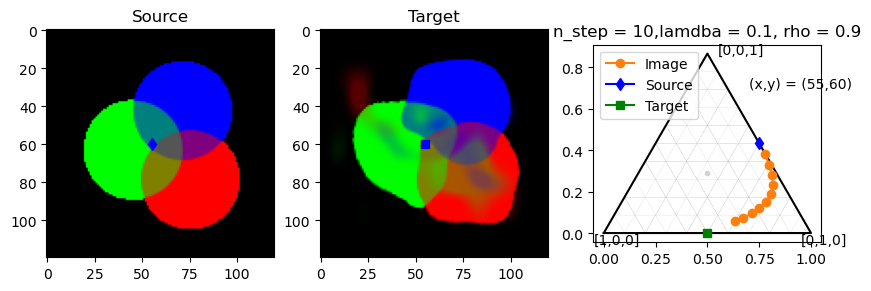

In [30]:
# coord_x,coord_y = 44,80
coord_x,coord_y = 55,60

plot_trajectory(mr,coord_x,coord_y,save=save)

# show_integration(mr,save=False)

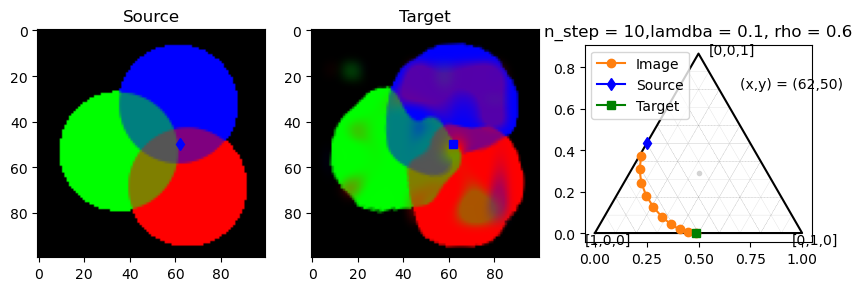

In [115]:
coord_x,coord_y = 75,17
coord_x,coord_y = 62,50



plot_trajectory(mr,coord_x,coord_y)

In [110]:


# plt.savefig(f"{path_save}{name}_{mr.mp},lambda={mr.cost_cst}_SimplexPlot.png")
# ic(imgs[:,0,0,:])

## run batch

reg 1/13: rho = 0.00 
Progress: [##########] 100.00% Done...  ,    0.00).
 (ssd :  ,    0.00).
Computation of forward done in  0:03:46s and 0.768cents  s
SSD = 0.00, distance to simplex = 0.000
I am saving mp
No landmark detected
Optimisation saved in /home/turtlefox/Documents/Doctorat/gliomorph/my_metamorphosis/saved_optim/2D_02_07_2024_random04_to_rho_0.00_001.pk1



ic| 1448204125.py:70 in plot_endresult()
    image_ts.shape: (120, 120, 4)
ic| 1448204125.py:52 in get_resi_cumul_onTarget()
    mr.mp.residuals_stock[i].min(): tensor(-0.5722)
    mr.mp.residuals_stock[i].max(): tensor(1.6781)
ic| 1448204125.py:54 in get_resi_cumul_onTarget()
    resi_sum.min(): tensor(-0.0572)
    resi_sum.max(): tensor(0.1678)
ic| 1448204125.py:52 in get_resi_cumul_onTarget()
    mr.mp.residuals_stock[i].min(): tensor(-0.6366)
    mr.mp.residuals_stock[i].max(): tensor(1.6321)
ic| 1448204125.py:54 in get_resi_cumul_onTarget()
    resi_sum.min(): tensor(-0.1203)
    resi_sum.max(): tensor(0.3310)
ic| 1448204125.py:52 in get_resi_cumul_onTarget()
    mr.mp.residuals_stock[i].min(): tensor(-0.7183)
    mr.mp.residuals_stock[i].max(): tensor(1.5445)
ic| 1448204125.py:54 in get_resi_cumul_onTarget()
    resi_sum.min(): tensor(-0.1902)
    resi_sum.max(): tensor(0.4855)
ic| 1448204125.py:52 in get_resi_cumul_onTarget()
    mr.mp.residuals_stock[i].min(): tensor(-0.8244)
 

reg 2/13: rho = 0.08 
Progress: [##--------]  17.67%  (ssd :  ,  124.39).

KeyboardInterrupt: 

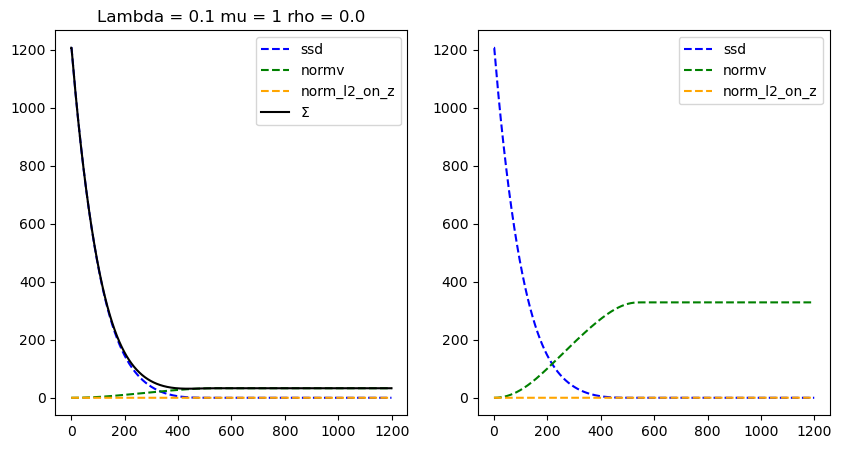

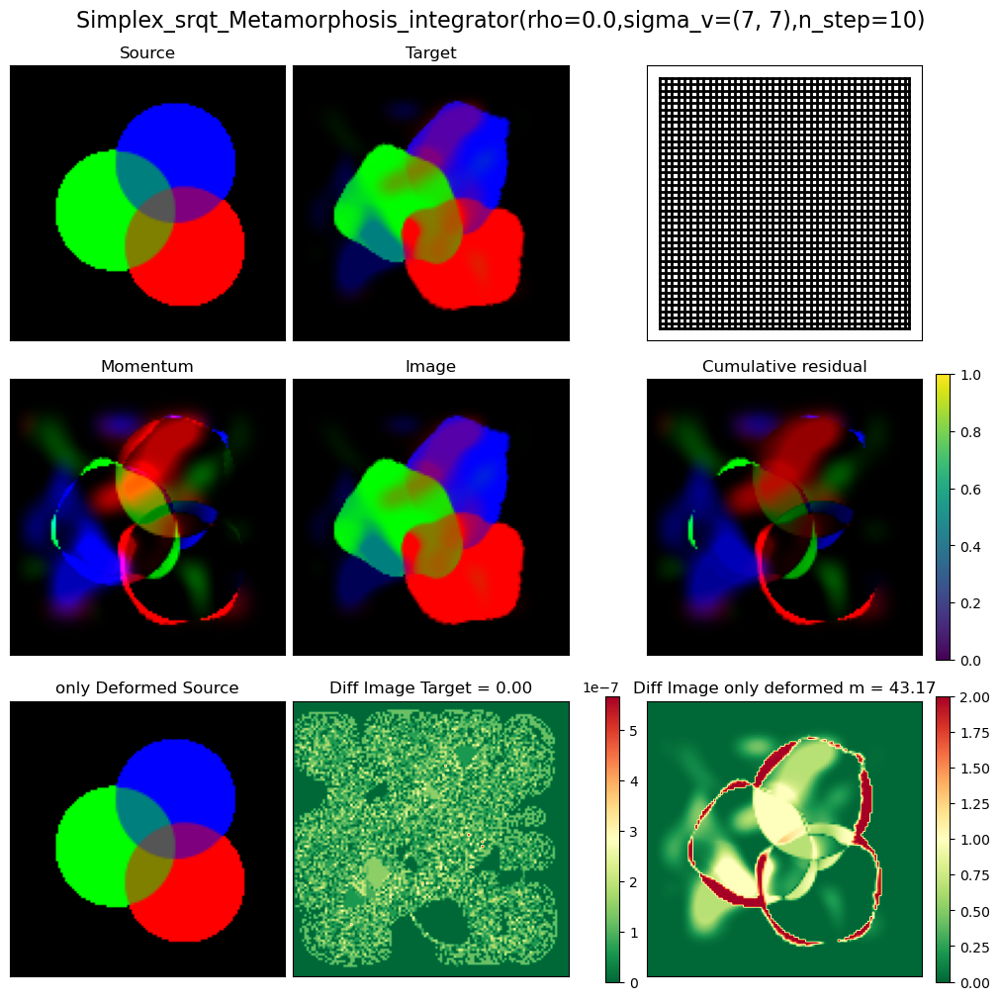

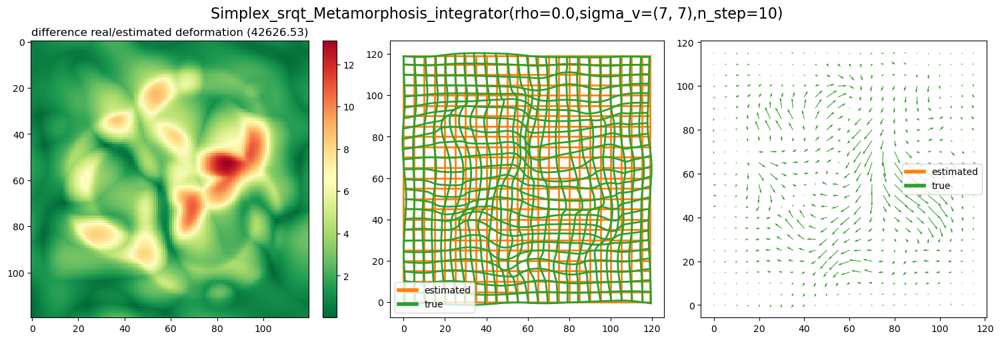

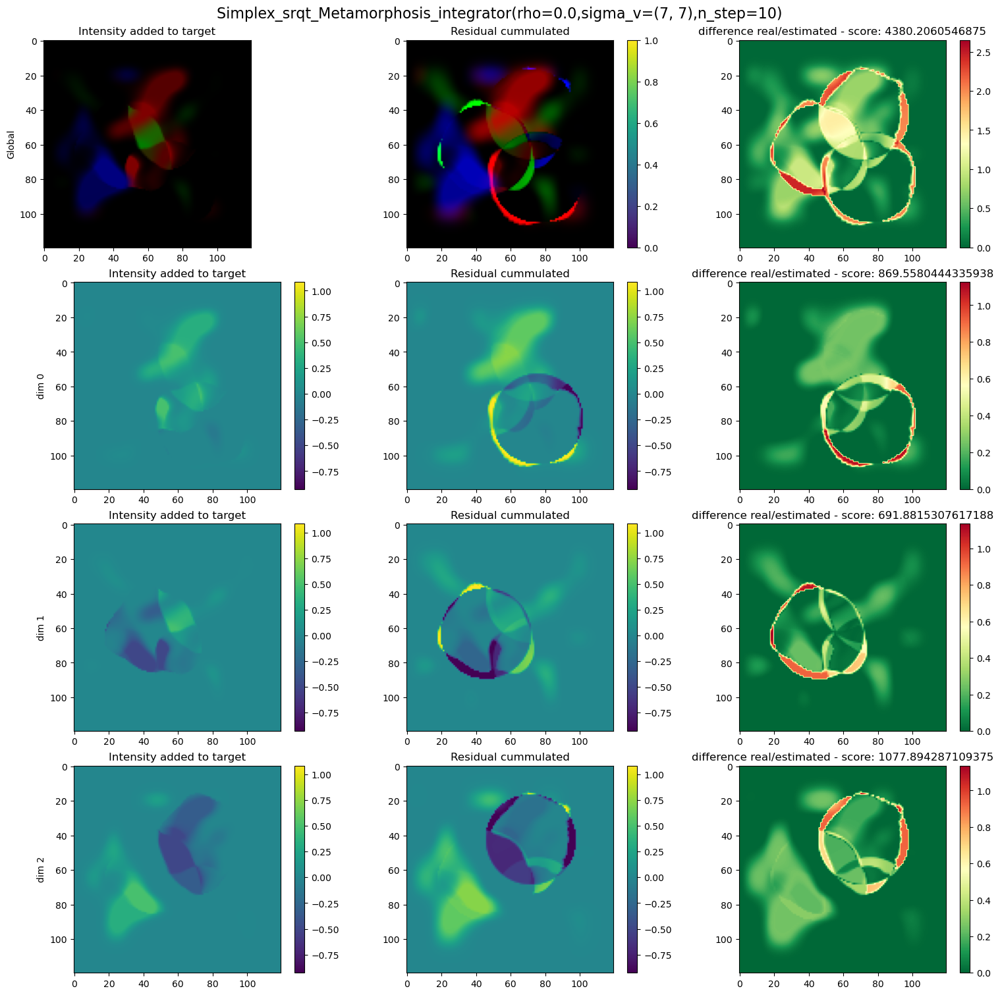

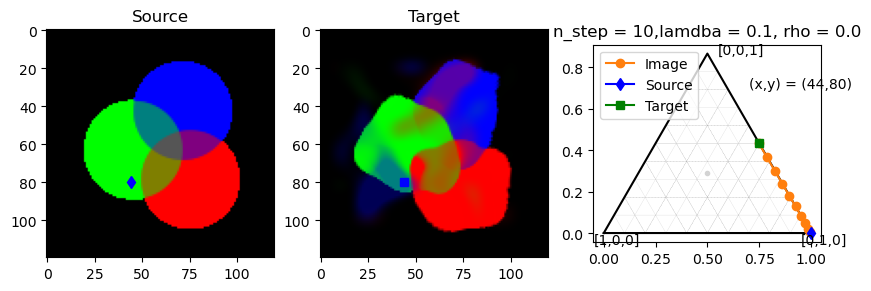

In [16]:


sigma = (7,7)
rho_list = np.linspace(0,1,13)
end_results_list = []
for i,rho in enumerate(rho_list):
    print(f"reg {i+1}/{len(rho_list)}: rho = {rho:.2f} ")
    momentum_ini = torch.zeros_like(source)
    momentum_ini.requires_grad = True
    
    mr = simplex_metamorphosis(source,target,momentum_ini,sigma,rho,
                               n_step=10,
                               n_iter=1200,
                               grad_coef=1,
                               cost_cst=.1,
                               plot=False)
    
    ssd = ((mr.mp.image**2 - mr.target**2)**2).sum()/prod(mr.mp.image.shape[2:])
    dist_to_simplex = float((mr.mp.image**2).sum(axis=1).mean()-1)
    print(f"SSD = {ssd:.2f}, distance to simplex = {dist_to_simplex:.3f}")
    
    mr.save(f"{name}",f"rho_{rho:.2f}")
    save_fig = True
    fig_cost,_ = mr.plot_cost()
    fig_cost.savefig(f"{path_save}{name}_{mr.mp}_cost.png")
    end_result = plot_endresult(mr,save=save_fig, retrun_all=True)
    end_result['deform_score'] =  plot_deform_cmp(mr,deform,save=save_fig)

    end_result['resi_score'] = plot_resi_cmp(end_result,save=save_fig)
    end_results_list.append(end_result)
    coord_x,coord_y = 44,80
    plot_trajectory(mr,coord_x,coord_y,save=save_fig)

array([0.   , 0.125, 0.25 , 0.375, 0.5  , 0.625, 0.75 , 0.875, 1.   ])

# Visualisation of saved optimisation

DT: None
New optimiser loaded (2D_02_07_2024_random04_to_rho_1.00_000.pk1) :
 Simplex_sqrt_Shooting(cost_parameters : {
		mu =1, 
		rho =1.0, 
		lambda =0.1
	},
	geodesic integrator : Simplex_srqt_Metamorphosis_integrator(rho=1.0,sigma_v=(7, 7),n_step=10)
	integration method : step
	optimisation method : adadelta
	# geodesic steps =10
)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:97 in plot_endresult()
    residual_cumul.shape: torch.Size([120, 120, 4])
ic| 218571680.py:196 in plot_resi_cmp()
    intensity.min(): tensor(-0.5026)
    intensity.max(): tensor(0.5000)
    end_result['residual_cumul'].min(): tensor(0.)
    end_result['residual_cumul'].max(): tensor(0.)
ic| 218571680.py:197 in plot_resi_cmp()
    intensity.shape: torch.Size([1, 4, 120, 120])
    end_result['residual_cumul'].shape: torch.Size([120, 120, 4])
ic| 218571680.py:198 in plot_resi_cmp()
    end_result['residual_cumul'].permute(2,0,1)[None].shape: torch.Size([1, 4, 120, 120])
ic| 218571680.py:202 in plot_resi_cmp()
    resi_simi.shape: (120, 120)
    resi_simi.sum(): 2007.6914
    resi_simi.min(): 0.0
    resi_simi.max(): 1.005245
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:219 in plot_

DT: None
New optimiser loaded (2D_02_07_2024_random04_to_rho_0.92_000.pk1) :
 Simplex_sqrt_Shooting(cost_parameters : {
		mu =1, 
		rho =0.9166666666666666, 
		lambda =0.1
	},
	geodesic integrator : Simplex_srqt_Metamorphosis_integrator(rho=0.9166666666666666,sigma_v=(7, 7),n_step=10)
	integration method : step
	optimisation method : adadelta
	# geodesic steps =10
)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:97 in plot_endresult()
    residual_cumul.shape: torch.Size([120, 120, 4])
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:196 in plot_resi_cmp()
    intensity.min(): tensor(-0.5026)
    intensity.max(): tensor(0.5000)
    end_result['residual_cumul'].min(): tensor(-0.7465)
    end_result['residual_cumul'].max(): tensor(0.6757)
ic| 218571680.py:197 in plot_resi_cmp()
    intensity.shape: torch.Size([1, 4, 120, 120])
    end_result['residual_cumul'].shape: torch.Size([120, 120, 4])
ic| 218571680.py:198 in plot_resi_cmp()
    end_result['residual_cumul'].permute(2,0,1)[None].shape: torch.Size([1, 4, 120, 120])
ic| 218571680.py:202 in plot_resi_cmp()
    resi_simi.shape: (120, 120)
    resi_simi.sum(): 2098.3347
    resi_simi.min(): 6.056427e-23
    resi_simi.max(): 1.4949523
Clipping i

DT: None
New optimiser loaded (2D_02_07_2024_random04_to_rho_0.83_000.pk1) :
 Simplex_sqrt_Shooting(cost_parameters : {
		mu =1, 
		rho =0.8333333333333333, 
		lambda =0.1
	},
	geodesic integrator : Simplex_srqt_Metamorphosis_integrator(rho=0.8333333333333333,sigma_v=(7, 7),n_step=10)
	integration method : step
	optimisation method : adadelta
	# geodesic steps =10
)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:97 in plot_endresult()
    residual_cumul.shape: torch.Size([120, 120, 4])
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:196 in plot_resi_cmp()
    intensity.min(): tensor(-0.5026)
    intensity.max(): tensor(0.5000)
    end_result['residual_cumul'].min(): tensor(-0.9884)
    end_result['residual_cumul'].max(): tensor(0.7452)
ic| 218571680.py:197 in plot_resi_cmp()
    intensity.shape: torch.Size([1, 4, 120, 120])
    end_result['residual_cumul'].shape: torch.Size([120, 120, 4])
ic| 218571680.py:198 in plot_resi_cmp()
    end_result['residual_cumul'].permute(2,0,1)[None].shape: torch.Size([1, 4, 120, 120])
ic| 218571680.py:202 in plot_resi_cmp()
    resi_simi.shape: (120, 120)
    resi_simi.sum(): 2430.35
    resi_simi.min(): 3.17451e-26
    resi_simi.max(): 1.5443497
Clipping inpu

DT: None
New optimiser loaded (2D_02_07_2024_random04_to_rho_0.75_000.pk1) :
 Simplex_sqrt_Shooting(cost_parameters : {
		mu =1, 
		rho =0.75, 
		lambda =0.1
	},
	geodesic integrator : Simplex_srqt_Metamorphosis_integrator(rho=0.75,sigma_v=(7, 7),n_step=10)
	integration method : step
	optimisation method : adadelta
	# geodesic steps =10
)


ic| 218571680.py:97 in plot_endresult()
    residual_cumul.shape: torch.Size([120, 120, 4])
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:196 in plot_resi_cmp()
    intensity.min(): tensor(-0.5026)
    intensity.max(): tensor(0.5000)
    end_result['residual_cumul'].min(): tensor(-1.0767)
    end_result['residual_cumul'].max(): tensor(0.9748)
ic| 218571680.py:197 in plot_resi_cmp()
    intensity.shape: torch.Size([1, 4, 120, 120])
    end_result['residual_cumul'].shape: torch.Size([120, 120, 4])
ic| 218571680.py:198 in plot_resi_cmp()
    end_result['residual_cumul'].permute(2,0,1)[None].shape: torch.Size([1, 4, 120, 120])
ic| 218571680.py:202 in plot_resi_cmp()
    resi_simi.shape: (120, 120)
    resi_simi.sum(): 2574.8215
    resi_simi.min(): 2.6772943e-30
    resi_simi.max(): 1.8549482
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping 

DT: None
New optimiser loaded (2D_02_07_2024_random04_to_rho_0.67_000.pk1) :
 Simplex_sqrt_Shooting(cost_parameters : {
		mu =1, 
		rho =0.6666666666666666, 
		lambda =0.1
	},
	geodesic integrator : Simplex_srqt_Metamorphosis_integrator(rho=0.6666666666666666,sigma_v=(7, 7),n_step=10)
	integration method : step
	optimisation method : adadelta
	# geodesic steps =10
)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:97 in plot_endresult()
    residual_cumul.shape: torch.Size([120, 120, 4])
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:196 in plot_resi_cmp()
    intensity.min(): tensor(-0.5026)
    intensity.max(): tensor(0.5000)
    end_result['residual_cumul'].min(): tensor(-1.0770)
    end_result['residual_cumul'].max(): tensor(1.0374)
ic| 218571680.py:197 in plot_resi_cmp()
    intensity.shape: torch.Size([1, 4, 120, 120])
    end_result['residual_cumul'].shape: torch.Size([120, 120, 4])
ic| 218571680.py:198 in plot_resi_cmp()
    end_result['residual_cumul'].permute(2,0,1)[None].shape: torch.Size([1, 4, 120, 120])
ic| 218571680.py:202 in plot_resi_cmp()
    resi_simi.shape: (120, 120)
    resi_simi.sum(): 2729.6746
    resi_simi.min(): 3.9170377e-33
    resi_simi.max(): 2.4206798
Clipping 

DT: None
New optimiser loaded (2D_02_07_2024_random04_to_rho_0.58_000.pk1) :
 Simplex_sqrt_Shooting(cost_parameters : {
		mu =1, 
		rho =0.5833333333333333, 
		lambda =0.1
	},
	geodesic integrator : Simplex_srqt_Metamorphosis_integrator(rho=0.5833333333333333,sigma_v=(7, 7),n_step=10)
	integration method : step
	optimisation method : adadelta
	# geodesic steps =10
)


/home/turtlefox/Documents/Doctorat/gliomorph/image_3d_visualisation/../my_metamorphosis/metamorphosis.py:1104: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1,ax1 = plt.subplots(1,2,figsize=(10,5))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:97 in plot_endresult()
    residual_cumul.shape: torch.Size([120, 120, 4])
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:196 in plot_resi_cmp()
    intensity.min(): tensor(-0.5026)
    intensity.max(): tensor(0.5000)
    end_result['residual_cumul'].min(): tensor(-1.1963)
    end_result['residual_cumul'].max(): tensor(1.2629)
ic| 218571680.py:197 in plot_resi_cmp(

DT: None
New optimiser loaded (2D_02_07_2024_random04_to_rho_0.50_000.pk1) :
 Simplex_sqrt_Shooting(cost_parameters : {
		mu =1, 
		rho =0.5, 
		lambda =0.1
	},
	geodesic integrator : Simplex_srqt_Metamorphosis_integrator(rho=0.5,sigma_v=(7, 7),n_step=10)
	integration method : step
	optimisation method : adadelta
	# geodesic steps =10
)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:97 in plot_endresult()
    residual_cumul.shape: torch.Size([120, 120, 4])
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:196 in plot_resi_cmp()
    intensity.min(): tensor(-0.5026)
    intensity.max(): tensor(0.5000)
    end_result['residual_cumul'].min(): tensor(-1.4035)
    end_result['residual_cumul'].max(): tensor(1.1498)
ic| 218571680.py:197 in plot_resi_cmp()
    intensity.shape: torch.Size([1, 4, 120, 120])
    end_result['residual_cumul'].shape: torch.Size([120, 120, 4])
ic| 218571680.py:198 in plot_resi_cmp()
    end_result['residual_cumul'].permute(2,0,1)[None].shape: torch.Size([1, 4, 120, 120])
ic| 218571680.py:202 in plot_resi_cmp()
    resi_simi.shape: (120, 120)
    resi_simi.sum(): 3006.8638
    resi_simi.min(): 4.5207817e-38
    resi_simi.max(): 2.6978445
Clipping 

DT: None
New optimiser loaded (2D_02_07_2024_random04_to_rho_0.42_000.pk1) :
 Simplex_sqrt_Shooting(cost_parameters : {
		mu =1, 
		rho =0.41666666666666663, 
		lambda =0.1
	},
	geodesic integrator : Simplex_srqt_Metamorphosis_integrator(rho=0.41666666666666663,sigma_v=(7, 7),n_step=10)
	integration method : step
	optimisation method : adadelta
	# geodesic steps =10
)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:97 in plot_endresult()
    residual_cumul.shape: torch.Size([120, 120, 4])
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:196 in plot_resi_cmp()
    intensity.min(): tensor(-0.5026)
    intensity.max(): tensor(0.5000)
    end_result['residual_cumul'].min(): tensor(-1.0448)
    end_result['residual_cumul'].max(): tensor(1.2233)
ic| 218571680.py:197 in plot_resi_cmp()
    intensity.shape: torch.Size([1, 4, 120, 120])
    end_result['residual_cumul'].shape: torch.Size([120, 120, 4])
ic| 218571680.py:198 in plot_resi_cmp()
    end_result['residual_cumul'].permute(2,0,1)[None].shape: torch.Size([1, 4, 120, 120])
ic| 218571680.py:202 in plot_resi_cmp()
    resi_simi.shape: (120, 120)
    resi_simi.sum(): 3097.7312
    resi_simi.min(): 3.35032e-40
    resi_simi.max(): 2.7174559
Clipping in

DT: None
New optimiser loaded (2D_02_07_2024_random04_to_rho_0.33_000.pk1) :
 Simplex_sqrt_Shooting(cost_parameters : {
		mu =1, 
		rho =0.3333333333333333, 
		lambda =0.1
	},
	geodesic integrator : Simplex_srqt_Metamorphosis_integrator(rho=0.3333333333333333,sigma_v=(7, 7),n_step=10)
	integration method : step
	optimisation method : adadelta
	# geodesic steps =10
)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:97 in plot_endresult()
    residual_cumul.shape: torch.Size([120, 120, 4])
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:196 in plot_resi_cmp()
    intensity.min(): tensor(-0.5026)
    intensity.max(): tensor(0.5000)
    end_result['residual_cumul'].min(): tensor(-1.1377)
    end_result['residual_cumul'].max(): tensor(1.1447)
ic| 218571680.py:197 in plot_resi_cmp()
    intensity.shape: torch.Size([1, 4, 120, 120])
    end_result['residual_cumul'].shape: torch.Size([120, 120, 4])
ic| 218571680.py:198 in plot_resi_cmp()
    end_result['residual_cumul'].permute(2,0,1)[None].shape: torch.Size([1, 4, 120, 120])
ic| 218571680.py:202 in plot_resi_cmp()
    resi_simi.shape: (120, 120)
    resi_simi.sum(): 3140.0547
    resi_simi.min(): 1.3127e-41
    resi_simi.max(): 2.729022
Clipping inpu

DT: None
New optimiser loaded (2D_02_07_2024_random04_to_rho_0.25_000.pk1) :
 Simplex_sqrt_Shooting(cost_parameters : {
		mu =1, 
		rho =0.25, 
		lambda =0.1
	},
	geodesic integrator : Simplex_srqt_Metamorphosis_integrator(rho=0.25,sigma_v=(7, 7),n_step=10)
	integration method : step
	optimisation method : adadelta
	# geodesic steps =10
)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:97 in plot_endresult()
    residual_cumul.shape: torch.Size([120, 120, 4])
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:196 in plot_resi_cmp()
    intensity.min(): tensor(-0.5026)
    intensity.max(): tensor(0.5000)
    end_result['residual_cumul'].min(): tensor(-1.0685)
    end_result['residual_cumul'].max(): tensor(1.1427)
ic| 218571680.py:197 in plot_resi_cmp()
    intensity.shape: torch.Size([1, 4, 120, 120])
    end_result['residual_cumul'].shape: torch.Size([120, 120, 4])
ic| 218571680.py:198 in plot_resi_cmp()
    end_result['residual_cumul'].permute(2,0,1)[None].shape: torch.Size([1, 4, 120, 120])
ic| 218571680.py:202 in plot_resi_cmp()
    resi_simi.shape: (120, 120)
    resi_simi.sum(): 3191.4888
    resi_simi.min(): 7.29e-43
    resi_simi.max(): 2.7245295
Clipping input

DT: None
New optimiser loaded (2D_02_07_2024_random04_to_rho_0.17_000.pk1) :
 Simplex_sqrt_Shooting(cost_parameters : {
		mu =1, 
		rho =0.16666666666666666, 
		lambda =0.1
	},
	geodesic integrator : Simplex_srqt_Metamorphosis_integrator(rho=0.16666666666666666,sigma_v=(7, 7),n_step=10)
	integration method : step
	optimisation method : adadelta
	# geodesic steps =10
)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:97 in plot_endresult()
    residual_cumul.shape: torch.Size([120, 120, 4])
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:196 in plot_resi_cmp()
    intensity.min(): tensor(-0.5026)
    intensity.max(): tensor(0.5000)
    end_result['residual_cumul'].min(): tensor(-0.9611)
    end_result['residual_cumul'].max(): tensor(1.1824)
ic| 218571680.py:197 in plot_resi_cmp()
    intensity.shape: torch.Size([1, 4, 120, 120])
    end_result['residual_cumul'].shape: torch.Size([120, 120, 4])
ic| 218571680.py:198 in plot_resi_cmp()
    end_result['residual_cumul'].permute(2,0,1)[None].shape: torch.Size([1, 4, 120, 120])
ic| 218571680.py:202 in plot_resi_cmp()
    resi_simi.shape: (120, 120)
    resi_simi.sum(): 3273.7363
    resi_simi.min(): 0.0
    resi_simi.max(): 2.5398147
Clipping input data

DT: None
New optimiser loaded (2D_02_07_2024_random04_to_rho_0.08_000.pk1) :
 Simplex_sqrt_Shooting(cost_parameters : {
		mu =1, 
		rho =0.08333333333333333, 
		lambda =0.1
	},
	geodesic integrator : Simplex_srqt_Metamorphosis_integrator(rho=0.08333333333333333,sigma_v=(7, 7),n_step=10)
	integration method : step
	optimisation method : adadelta
	# geodesic steps =10
)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:97 in plot_endresult()
    residual_cumul.shape: torch.Size([120, 120, 4])
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:196 in plot_resi_cmp()
    intensity.min(): tensor(-0.5026)
    intensity.max(): tensor(0.5000)
    end_result['residual_cumul'].min(): tensor(-0.9384)
    end_result['residual_cumul'].max(): tensor(1.1039)
ic| 218571680.py:197 in plot_resi_cmp()
    intensity.shape: torch.Size([1, 4, 120, 120])
    end_result['residual_cumul'].shape: torch.Size([120, 120, 4])
ic| 218571680.py:198 in plot_resi_cmp()
    end_result['residual_cumul'].permute(2,0,1)[None].shape: torch.Size([1, 4, 120, 120])
ic| 218571680.py:202 in plot_resi_cmp()
    resi_simi.shape: (120, 120)
    resi_simi.sum(): 3349.5845
    resi_simi.min(): 0.0
    resi_simi.max(): 2.5275364
Clipping input data

DT: None
New optimiser loaded (2D_02_07_2024_random04_to_rho_0.00_000.pk1) :
 Simplex_sqrt_Shooting(cost_parameters : {
		mu =1, 
		rho =0.0, 
		lambda =0.1
	},
	geodesic integrator : Simplex_srqt_Metamorphosis_integrator(rho=0.0,sigma_v=(7, 7),n_step=10)
	integration method : step
	optimisation method : adadelta
	# geodesic steps =10
)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:97 in plot_endresult()
    residual_cumul.shape: torch.Size([120, 120, 4])
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
ic| 218571680.py:196 in plot_resi_cmp()
    intensity.min(): tensor(-0.5026)
    intensity.max(): tensor(0.5000)
    end_result['residual_cumul'].min(): tensor(-0.9326)
    end_result['residual_cumul'].max(): tensor(1.0844)
ic| 218571680.py:197 in plot_resi_cmp()
    intensity.shape: torch.Size([1, 4, 120, 120])
    end_result['residual_cumul'].shape: torch.Size([120, 120, 4])
ic| 218571680.py:198 in plot_resi_cmp()
    end_result['residual_cumul'].permute(2,0,1)[None].shape: torch.Size([1, 4, 120, 120])
ic| 218571680.py:202 in plot_resi_cmp()
    resi_simi.shape: (120, 120)
    resi_simi.sum(): 3428.5618
    resi_simi.min(): 0.0
    resi_simi.max(): 2.6472354
Clipping input data

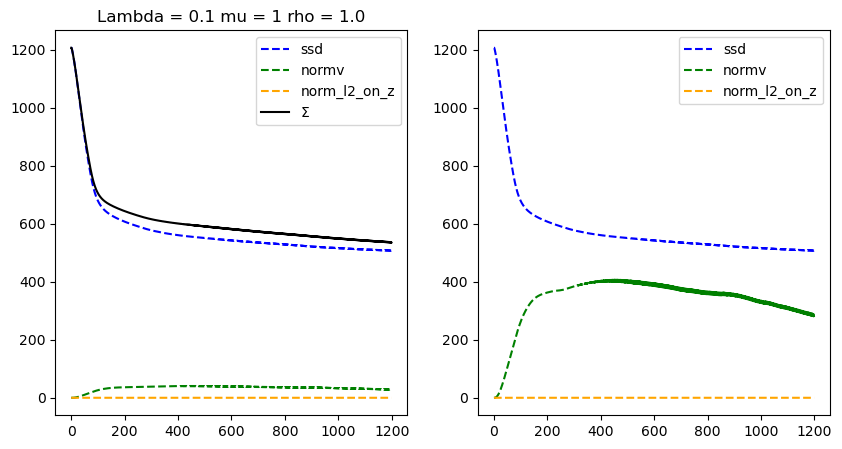

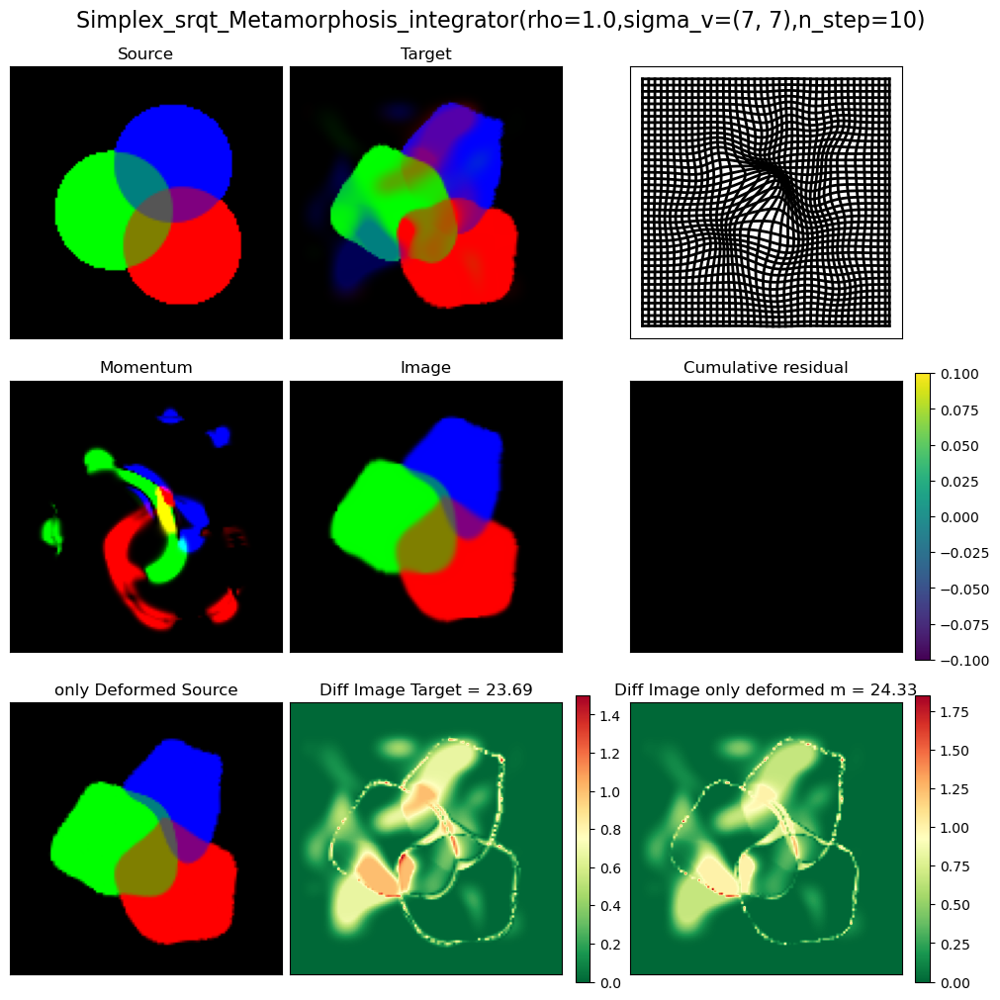

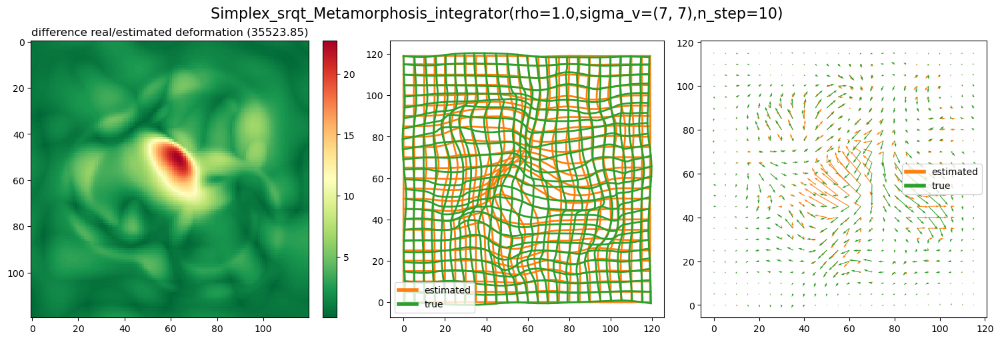

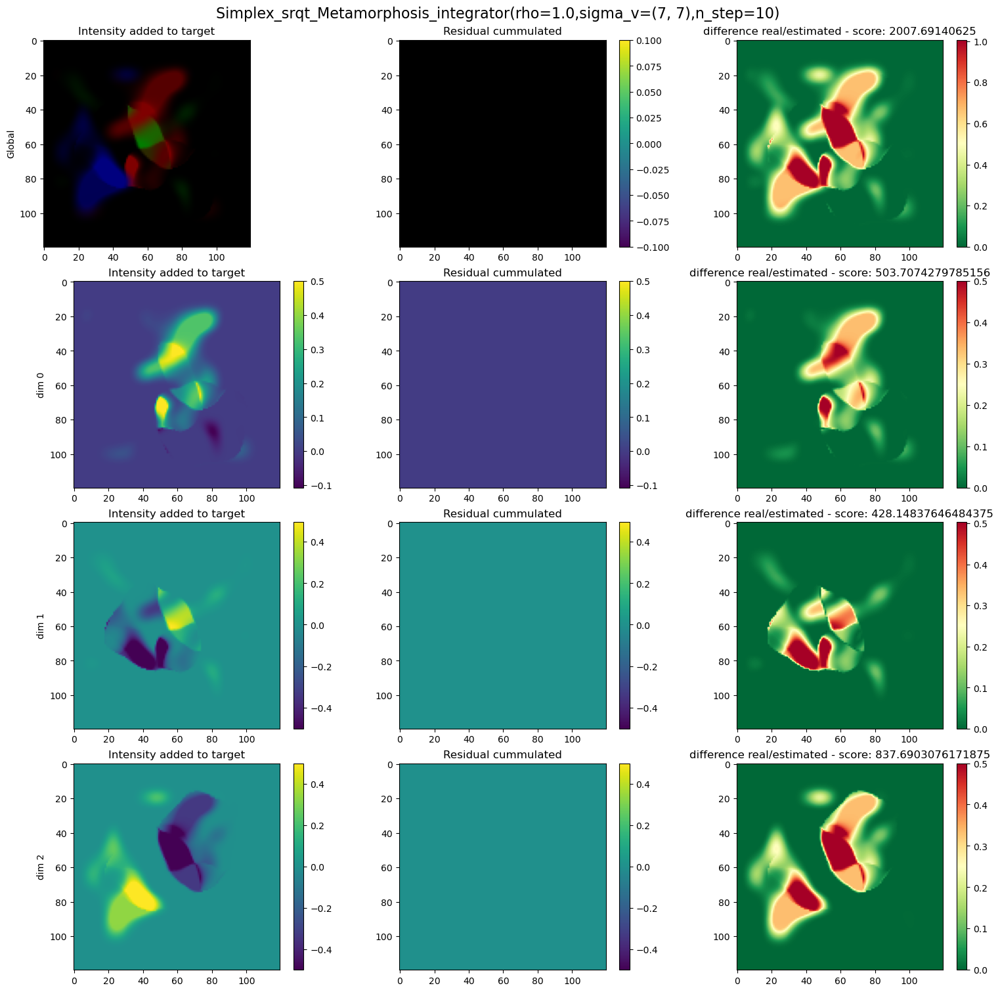

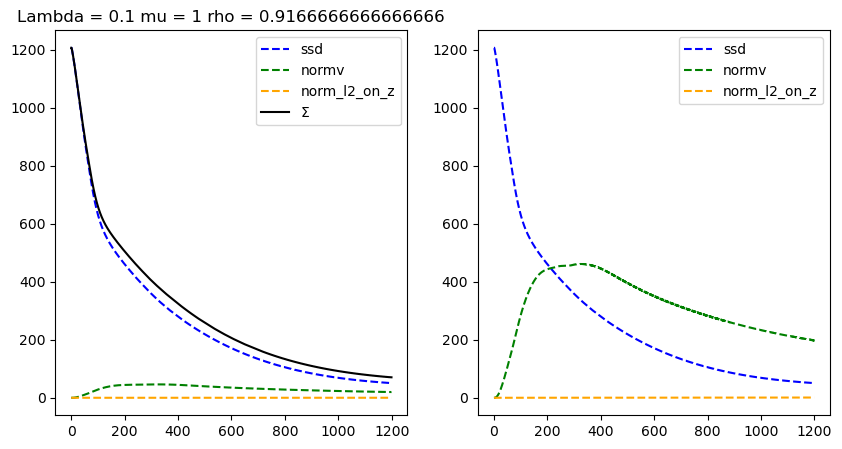

...

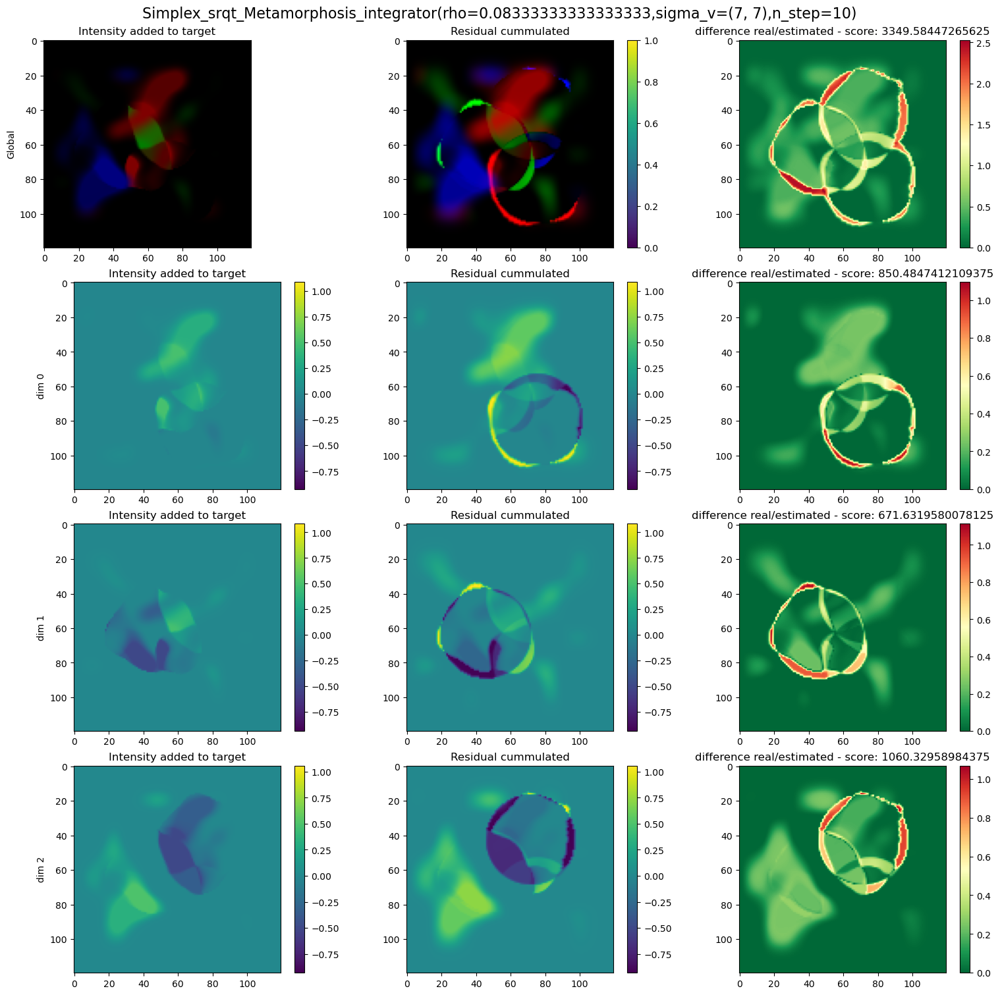

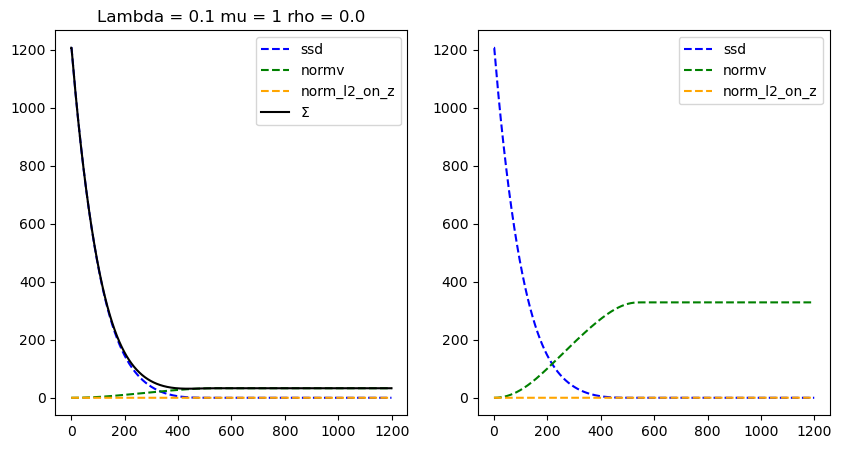

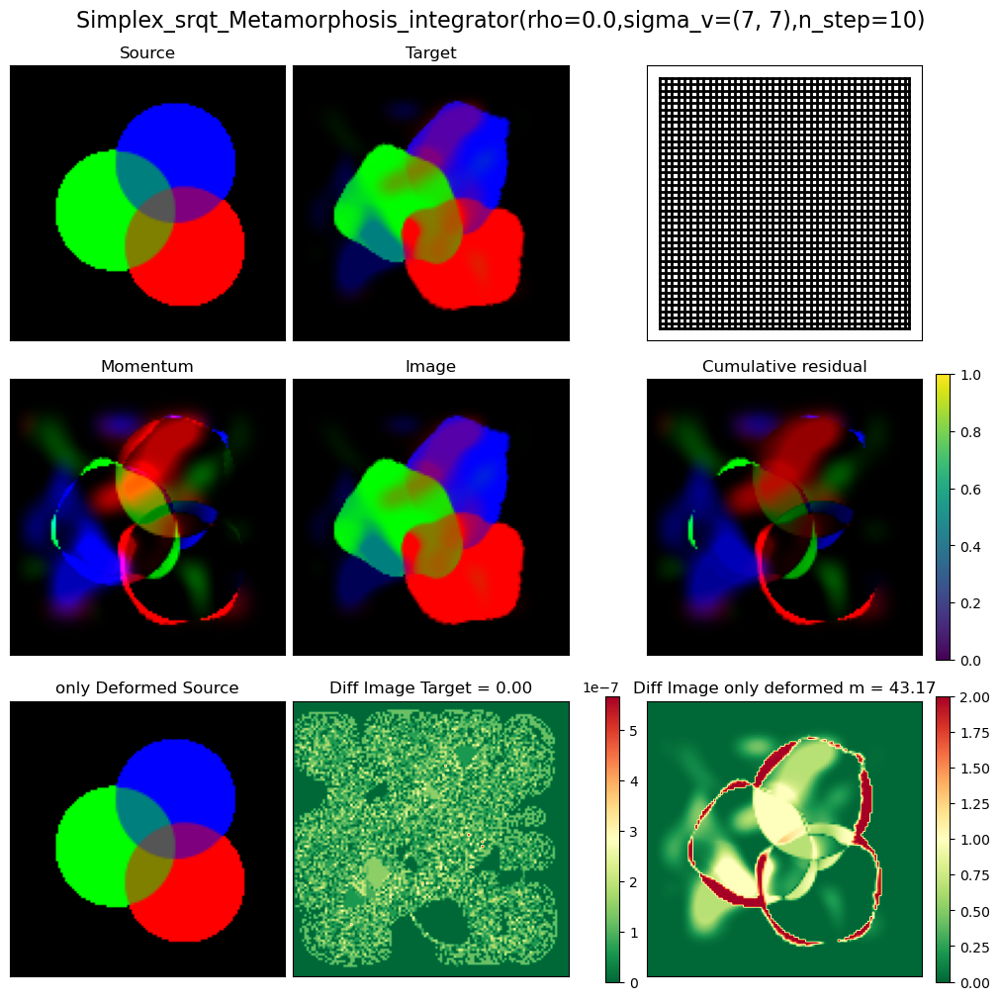

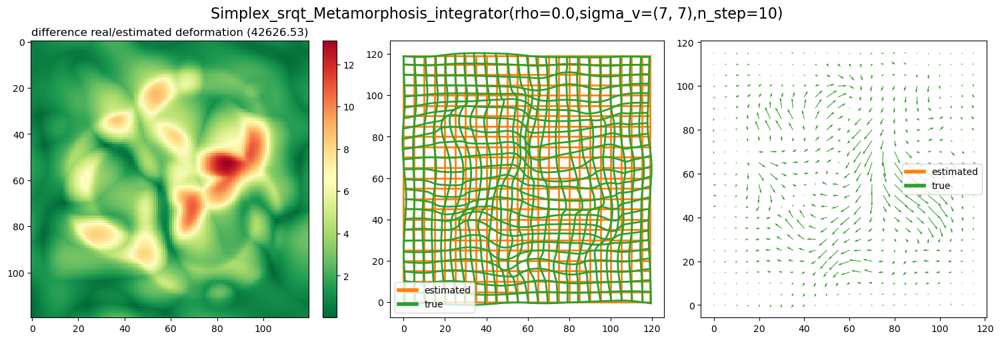

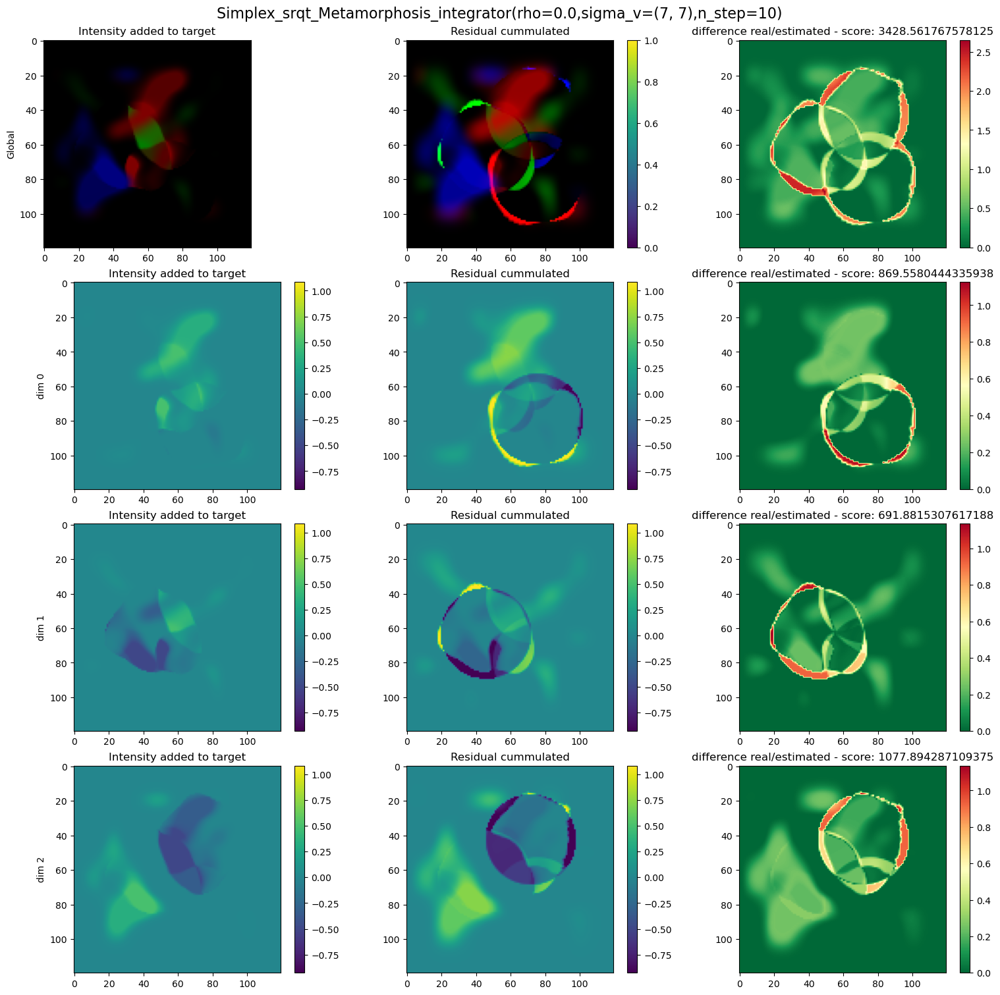

In [38]:
list_saved_optim = [
"2D_02_07_2024_random04_to_rho_1.00_000.pk1",
"2D_02_07_2024_random04_to_rho_0.92_000.pk1",
"2D_02_07_2024_random04_to_rho_0.83_000.pk1",
"2D_02_07_2024_random04_to_rho_0.75_000.pk1",
"2D_02_07_2024_random04_to_rho_0.67_000.pk1",
"2D_02_07_2024_random04_to_rho_0.58_000.pk1",
"2D_02_07_2024_random04_to_rho_0.50_000.pk1",
"2D_02_07_2024_random04_to_rho_0.42_000.pk1",
"2D_02_07_2024_random04_to_rho_0.33_000.pk1",
"2D_02_07_2024_random04_to_rho_0.25_000.pk1",
"2D_02_07_2024_random04_to_rho_0.17_000.pk1",
"2D_02_07_2024_random04_to_rho_0.08_000.pk1",
"2D_02_07_2024_random04_to_rho_0.00_000.pk1",]
end_results_list = []

save = True
for opt in list_saved_optim:
    mr = mt.load_optimize_geodesicShooting(opt)
    mr.plot_cost()
    end_result = plot_endresult(mr,save=save, retrun_all=True)
    
    end_result['deform_score'] =  plot_deform_cmp(mr,deform,save=save)
    end_result['mr_params'] = mr.get_all_parameters()
    
    end_result['resi_score'] = plot_resi_cmp(end_result,save=save)
    coord_x,coord_y = 44,80
    # plot_trajectory(mr,coord_x,coord_y,save=save)
    end_results_list.append(end_result)

## View scores over rho
    

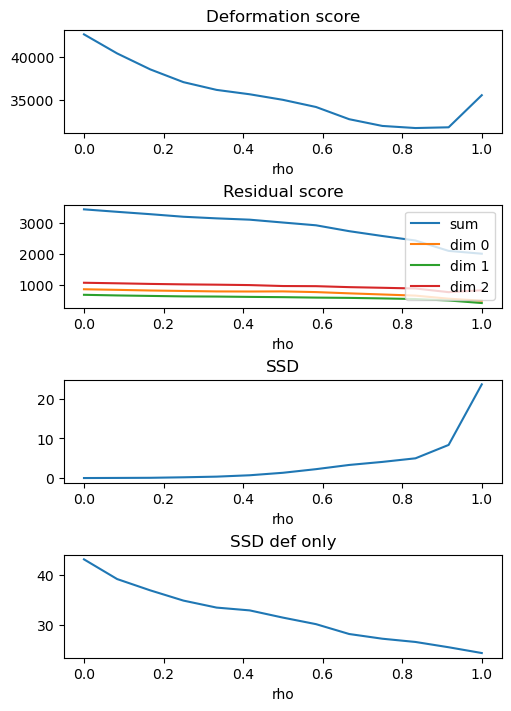

In [39]:
rho_list = [er['mr_params']['rho'] for er in end_results_list]
deform_score_list = [float(er['deform_score']) for er in end_results_list]
resi_score_list = np.array([
        [float(a) for a in er['resi_score']]
    for er in end_results_list 
])
metric_ssd_list = [er['metric_ssd'] for er in end_results_list]
metric_ssd_def_only_list = [er['metric_sdd_def_only'] for er in end_results_list]

fig,ax = plt.subplots(4,1,figsize=(5,7),constrained_layout=True)
ax[0].plot(rho_list,deform_score_list)
ax[0].set_title("Deformation score")
ax[0].set_xlabel("rho")

for i in range(resi_score_list.shape[1]):
    leg = "sum" if i == 0 else f"dim {i-1}"
    ax[1].plot(rho_list,resi_score_list[:,i],label=leg)
ax[1].set_title("Residual score")
ax[1].set_xlabel("rho")
ax[1].legend(loc="upper right")

ax[2].plot(rho_list,metric_ssd_list)
ax[2].set_title("SSD")
ax[2].set_xlabel("rho")

ax[3].plot(rho_list,metric_ssd_def_only_list)
ax[3].set_title("SSD def only")
ax[3].set_xlabel("rho")
plt.savefig(f"{path_save}{name}_allrho_scoreSummary.png")

In [37]:
# for er in end_results_list:
#     score_tuple = er['resi_score']
#     tuple([float(a) for a in score_tuple])
# 
# resi_score_list = [
#     er['resi_score'] for er in end_results_list]

resi_score_list = [
        [float(a) for a in er['resi_score']]
    for er in end_results_list 
]
resi_score_list

[[2.9802322387695312e-05,
  223.88528442382812,
  227.7407989501953,
  274.13519287109375],
 [5144.01318359375, 1067.28759765625, 1438.41943359375, 1631.13037109375],
 [4044.644287109375, 780.0717163085938, 1083.242431640625, 1198.2293701171875],
 [3639.31201171875, 684.1629028320312, 960.0736083984375, 1019.5471801757812],
 [3632.186767578125, 674.0904541015625, 961.809326171875, 977.1951904296875],
 [3517.697265625, 657.4745483398438, 921.7059326171875, 918.7052612304688],
 [3317.56298828125, 624.242919921875, 874.9920654296875, 840.79443359375],
 [3099.2490234375, 588.760009765625, 829.3002319335938, 757.353515625],
 [2586.8662109375, 477.31048583984375, 660.1693115234375, 636.1171875]]